<a href="https://colab.research.google.com/github/aruaru0/HuBmap/blob/main/768_update_0_72_b5_train_segformer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SegFormer Train

In [ ]:
!nvidia-smi

Wed Sep 14 22:32:05 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
%%capture
!pip install wandb --upgrade

In [ ]:
!cp /content/drive/MyDrive/Kaggle/netrc ~/.netrc

In [ ]:
import wandb
wandb.login()

ERROR:wandb.jupyter:Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: aruaru0. Use `wandb login --relogin` to force relogin


True

## kaggle

In [ ]:
!mkdir -p ~/.kaggle
!cp /content/drive/MyDrive/datas/kaggle.json  ~/.kaggle/

In [ ]:
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c hubmap-organ-segmentation

100% 5.77G/5.78G [00:55<00:00, 115MB/s]
100% 5.78G/5.78G [00:55<00:00, 111MB/s]


In [ ]:
# !mkdir hubmap
!unzip /content/hubmap-organ-segmentation.zip -d hubmap >/dev/null

In [ ]:
!pip install pytorch-lightning
!pip install transformers datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 707 kB 7.0 MB/s 
     |████████████████████████████████| 5.9 MB 56.8 MB/s 
     |████████████████████████████████| 419 kB 72.6 MB/s 
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.8.0
    Uninstalling tensorboard-2.8.0:
      Successfully uninstalled tensorboard-2.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.9 MB 8.2 MB/s 
     |████████████████████████████████| 365 kB 65.6 MB/s 
     |████████████████████████████████| 

In [ ]:
!pip install staintools
!pip install spams

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for staintools: filename=staintools-2.1.2-py3-none-any.whl size=14075 sha256=413995f2d543171a614778a53e56e8e77d4f2b1f6dc107a6714322a1b44de22b
  Stored in directory: /root/.cache/pip/wheels/9b/ed/74/9d36d40854e911d8e2d2d28d7b67e37e9f176f913ecf34f813
Successfully built staintools
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.0 MB 5.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for spams: filename=spams-2.6.5.4-cp37-cp37m-linux_x86_64.whl size=3236619 sha256=12acf3ce402b4f151679215c6083a496073ce95bebbbf8b296e323e53ef63aea
  Stored in directory: /root/.cache/pip/wheels/5e/92/17/e718e0e26bfcdd7e81afcf874ac2bc599dd7dd7f3ad78f9d76
Successfully built spams


In [ ]:
# from google.colab import output
# output.enable_custom_widget_manager()

## Start code

In [ ]:
import wandb
wandb.init(project="HuBMAP-SegFormer")

In [ ]:
%load_ext tensorboard

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
from torch.utils.tensorboard import SummaryWriter

In [ ]:
from typing import Optional, List

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ConstantLR, LinearLR
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset
import torchvision.transforms as transforms
import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint

# from timm import create_model

import numpy as np
import cv2
import matplotlib.pyplot as plt

import os
import albumentations as albu
import random

import pandas as pd

from tqdm.notebook import tqdm

from sklearn.model_selection import KFold

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


Moving 0 files to the new cache system


0it [00:00, ?it/s]

In [ ]:
#https://www.kaggle.com/code/pestipeti/decoding-rle-masks/notebook
def mask2rle(img):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    pixels= img.T.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)


def rle2mask(mask_rle, shape=(3000,3000)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (width,height) of array to return 
    Returns numpy array, 1 - mask, 0 - background

    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0::2], s[1::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T

##  load test data

In [ ]:
SEED = 2022 #43
BATCH_SIZE = 2
Gradient_Accumulation_Step = 14

In [ ]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    #the following line gives ~10% speedup
    #but may lead to some stochasticity in the results 
    torch.backends.cudnn.benchmark = True
    
seed_everything(SEED)

### FOLD

In [ ]:
DATA_DIR = './hubmap'
NFOLD = 3
FOLD = 0

WIDTH, HEIGHT = 768,768

model_path = '/content/drive/MyDrive/datas/HuBMAP/model-b5-fold{}.pth'.format(FOLD)
MODEL_NAME = "nvidia/mit-b5"
# MODEL_NAME = "nvidia/segformer-b3-finetuned-ade-512-512"

wandb.SEED = SEED
wandb.config.NFOLD = NFOLD
wandb.config.FOLD = FOLD
wandb.config.WIDTH = WIDTH
wandb.config.HEIGHT= HEIGHT
wandb.config.MODEL_NAME = MODEL_NAME

#
# nvidia/segformer-b0-finetuned-ade-512-512
# nvidia/segformer-b1-finetuned-ade-512-512
# nvidia/segformer-b2-finetuned-ade-512-512
# nvidia/segformer-b3-finetuned-ade-512-512
# nvidia/segformer-b4-finetuned-ade-512-512
# nvidia/segformer-b5-finetuned-ade-640-640
# https://huggingface.co/models?other=segformer&sort=downloads&search=nvidia%2Fsegformer+finetuned
#
df = pd.read_csv(DATA_DIR + '/train.csv')

In [ ]:
# df = df[df['organ']=='lung'].reset_index()
df

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female
...,...,...,...,...,...,...,...,...,...,...
346,9517,kidney,HPA,3000,3000,0.4,4,1611763 11 1614753 29 1617750 35 1620746 43 16...,61.0,Male
347,9769,kidney,HPA,3070,3070,0.4,4,4030400 28 4033466 34 4036526 48 4039594 54 40...,28.0,Male
348,9777,largeintestine,HPA,3000,3000,0.4,4,538473 13 541468 22 544463 30 547461 35 550459...,84.0,Male
349,9791,kidney,HPA,3000,3000,0.4,4,334733 33 337729 43 340729 43 343725 51 346723...,28.0,Male


In [ ]:
# class2idx = dict([(name,i+1) for i, name in enumerate(df.organ.unique())])
# class2idx['none'] = 0
# idx2class = dict([(class2idx[name], name) for name in class2idx])

class2idx = {'prostate': 1,
  'spleen': 2,
  'lung': 3,
  'kidney': 4,
  'largeintestine': 5,
  'none': 0}
idx2class = {1: 'prostate',
  2: 'spleen',
  3: 'lung',
  4: 'kidney',
  5: 'largeintestine',
  0: 'none'}

class2idx, idx2class

({'prostate': 1,
  'spleen': 2,
  'lung': 3,
  'kidney': 4,
  'largeintestine': 5,
  'none': 0},
 {1: 'prostate',
  2: 'spleen',
  3: 'lung',
  4: 'kidney',
  5: 'largeintestine',
  0: 'none'})

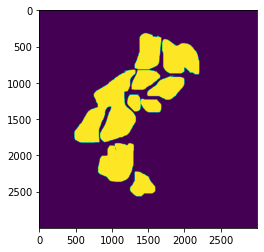

In [ ]:
idx = 0
height, width, rle = df['img_height'][idx], df['img_width'][idx], df['rle'][idx]
mask = rle2mask(rle, shape=(height, width))
plt.imshow(mask)

In [ ]:
from sklearn.model_selection import StratifiedKFold

df['fold'] = 0

skf = StratifiedKFold(n_splits=NFOLD)
for i, index in enumerate(skf.split(df.id, df.organ)):
  train_index, test_index = index
  # print("train_index:", train_index, "test_index:", test_index)
  # df['fold'][test_index] = i
  df.loc[test_index, 'fold'] = i

df

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex,fold
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male,0
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male,0
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male,0
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male,0
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female,0
...,...,...,...,...,...,...,...,...,...,...,...
346,9517,kidney,HPA,3000,3000,0.4,4,1611763 11 1614753 29 1617750 35 1620746 43 16...,61.0,Male,2
347,9769,kidney,HPA,3070,3070,0.4,4,4030400 28 4033466 34 4036526 48 4039594 54 40...,28.0,Male,2
348,9777,largeintestine,HPA,3000,3000,0.4,4,538473 13 541468 22 544463 30 547461 35 550459...,84.0,Male,2
349,9791,kidney,HPA,3000,3000,0.4,4,334733 33 337729 43 340729 43 343725 51 346723...,28.0,Male,2


## Utils

### augumentation

In [ ]:
import staintools

In [ ]:
class Stain(albu.ImageOnlyTransform):
    def __init__(
        self,
        method='vahadane', sigma1=0.2, sigma2=0.2,
        always_apply=False,
        p=0.5,
    ):
        super(Stain, self).__init__(always_apply, p)
        self.method = method
        self.sigma1 = sigma1
        self.sigma2 = sigma2
        self.augmentor = staintools.StainAugmentor(method=method, sigma1=sigma1, sigma2=sigma2)

    def apply(self, img, **params):
        self.augmentor.fit(img)
        return self.augmentor.pop().astype(int)

    def get_params(self):
        return {
        }

    def get_transform_init_args_names(self):
        return ("brightness_limit", "contrast_limit", "brightness_by_max")

In [ ]:
# ----- set0
def get_training_augmentation_set0(p=0.5):
    return albu.Compose([
        albu.Sequential([
          albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
          albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
        ], p=p),
        albu.HorizontalFlip(p=p),
        albu.VerticalFlip(p=p),
        albu.RandomRotate90(p=p),
        albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
                         border_mode=cv2.BORDER_REFLECT),
        # albu.OneOf([
        #     albu.OpticalDistortion(p=1),
        #     albu.GridDistortion(p=1),
        #     albu.IAAPiecewiseAffine(p=1),
        # ], p=p),
        albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=p),
        albu.OneOf([
            albu.CLAHE(clip_limit=2, p = 1),
            albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
            albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        ], p=p),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
    ], p=p)
# ---- set1
def get_training_augmentation_set1(p=0.5):
    return albu.Compose([
        albu.Sequential([
          albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
          albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
        ], p=p),
        albu.HorizontalFlip(p=p),
        albu.VerticalFlip(p=p),
        albu.RandomRotate90(p=p),
        # albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
        #                  border_mode=cv2.BORDER_REFLECT),
        albu.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=15, p=p, 
                         border_mode=cv2.BORDER_REFLECT),
        # albu.OneOf([
        #     albu.OpticalDistortion(p=1),
        #     albu.GridDistortion(p=1),
        #     albu.IAAPiecewiseAffine(p=1),
        # ], p=p),
        albu.ChannelShuffle(p=p),
        albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=p),
        albu.OneOf([
            albu.CLAHE(clip_limit=2, p = 1),
            albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
            albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        ], p=p),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
    ], p=p)


In [ ]:
def get_training_augmentation3(p=0.5):
    return albu.Compose([
        # albu.Sequential([
        #   albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
        #   albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
        # ], p=p),
        albu.HorizontalFlip(p=p),
        albu.VerticalFlip(p=p),
        albu.RandomRotate90(p=p),
        albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
                         border_mode=cv2.BORDER_REFLECT),
        # albu.OneOf([
        #     albu.OpticalDistortion(p=1),
        #     albu.GridDistortion(p=1),
        #     albu.IAAPiecewiseAffine(p=1),
        # ], p=p),
        albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=p),
        albu.OneOf([
            # albu.CLAHE(clip_limit=2, p = 1),
            albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
            albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        ], p=p),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
        # albu.CoarseDropout (max_holes=50, max_height=16, max_width=16, p=p)
    ], p=p)

# def get_training_augmentation3(p=0.5):
#     return albu.Compose([
#         albu.Sequential([
#           albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
#           albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
#         ], p=p),
#         albu.HorizontalFlip(p=p),
#         albu.VerticalFlip(p=p),
#         albu.RandomRotate90(p=p),
#         albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
#                          border_mode=cv2.BORDER_REFLECT),
#         # albu.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=15, p=p, 
#         #                  border_mode=cv2.BORDER_REFLECT),
#         # albu.OneOf([
#         #     albu.OpticalDistortion(p=1),
#         #     albu.GridDistortion(p=1),
#         #     albu.IAAPiecewiseAffine(p=1),
#         # ], p=p),
#         albu.OneOf([
#             albu.ChannelShuffle(p=1),
#             albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=1),
#             albu.CLAHE(clip_limit=2, p = 1),
#             albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
#             albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
#         ], p=p),
#         albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
#         albu.CoarseDropout (max_holes=50, max_height=16, max_width=16, p=p)
#     ], p=p)


In [ ]:
def get_training_augmentation2(p=1.0):
    return albu.Compose([
        albu.HorizontalFlip(),
        albu.VerticalFlip(),
        albu.RandomRotate90(),
        albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=0.9, 
                         border_mode=cv2.BORDER_REFLECT),
        albu.OneOf([
            albu.OpticalDistortion(p=0.3),
            albu.GridDistortion(p=.1),
            albu.IAAPiecewiseAffine(p=0.3),
        ], p=0.3),
        albu.OneOf([
            # albu.HueSaturationValue(10,15,10),
            albu.CLAHE(clip_limit=2),
            albu.RandomBrightnessContrast(),            
        ], p=0.3),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=0.3)
    ], p=p)

def get_training_augmentation():
    train_transform = [
        albu.PadIfNeeded(min_height=HEIGHT, min_width=WIDTH, always_apply=True, border_mode=0),
        albu.RandomCrop(height=HEIGHT, width=WIDTH, always_apply=True),
    ]
    return albu.Compose(train_transform)


def get_grayaug():
    train_transform = [
        albu.ToGray(p=1.0),
    ]
    return albu.Compose(train_transform)

# def get_validation_augmentation():
#     """画像のshapeが32で割り切れるようにPaddingするための関数"""
#     test_transform = [
#         albu.PadIfNeeded(384, 480)
#     ]
#     return albu.Compose(test_transform)

def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')

def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose    
    """
    
    _transform = [
        albu.Lambda(image=preprocessing_fn),
        albu.Lambda(image=to_tensor, mask=to_tensor),
    ]
    return albu.Compose(_transform)

# 可視化用の関数
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

## dataset

In [ ]:
from transformers import SegformerFeatureExtractor

mean = np.array([0.7720342, 0.74582646, 0.76392896])
std = np.array([0.24745085, 0.26182273, 0.25782376])

def img2tensor(img,dtype:np.dtype=np.float32):
    if img.ndim==2 : img = np.expand_dims(img,2)
    img = np.transpose(img,(2,0,1))
    return torch.from_numpy(img.astype(dtype, copy=False))


# 1. torch.utils.data.Datasetを継承したDataset classを定義
class Dataset(torch.utils.data.Dataset):
    # CLASSES = ['sky', 'building', 'pole', 'road', 'pavement', 
    #            'tree', 'signsymbol', 'fence', 'car', 
    #            'pedestrian', 'bicyclist', 'unlabelled']
    
    def __init__(
            self,
            image_dir, 
            df, # ファイル名一覧
            # classes=None, # 推論対象のクラス
            augmentation=None, # augmentation用関数
            preprocessing=None, # 前処理用関数
            width = 768,
            height = 768,
    ):
        self.image_dir = image_dir
        self.df = df
        self.augmentation = augmentation
        self.preprocessing = preprocessing
        self.width = width
        self.height = height
        self.feature_extractor = SegformerFeatureExtractor(MODEL_NAME , reduce_labels=False, size=(width, height))
    
    # 3. 学習用データ(image)と特徴(mask)を返す__getitem__メソッドを作成
    def __getitem__(self, i):
        # データの読み込み
        fname = "{}/{}.tiff".format(self.image_dir,self.df['id'][i])
        # print(fname)
        image = cv2.imread(fname)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        rle, w, h = self.df['rle'][i], self.df['img_width'][i], self.df['img_height'][i]
        idx = class2idx[self.df['organ'][i]]
        mask = rle2mask(rle, shape = (w, h))
        # print(self.df['organ'][i], idx)

        image = cv2.resize(image, (self.width, self.height))
        mask = cv2.resize(mask, (self.width, self.height)) * idx

        # augmentation関数の適用
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # print("image", image.shape)
        # # return image, mask
        # image = (image/255 - mean)/std
        
        # return img2tensor(image),torch.tensor(mask), idx
        # return image, mask
        encoded_inputs = self.feature_extractor(image, mask, return_tensors="pt")

        for k,v in encoded_inputs.items():
          encoded_inputs[k].squeeze_() # remove batch dimension

        return encoded_inputs

    # 4. データセットの長さを返す__len__を作成
    def __len__(self):
        return len(self.df)

torch.Size([3, 768, 768])


tensor([0, 5])

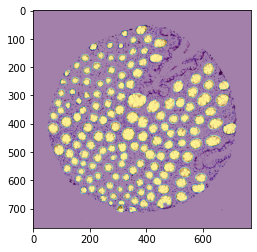

In [ ]:
IMAGE_DIR = './hubmap/train_images'
train_dataset = Dataset(IMAGE_DIR, df[df['fold'] != FOLD].reset_index(), width=WIDTH, height=HEIGHT)
input = train_dataset[0]
print(input['pixel_values'].shape)
plt.imshow(input['pixel_values'].permute(1,2,0).numpy())
plt.imshow(input['labels'], alpha=0.5)
input['labels'].unique()

In [ ]:
input

{'pixel_values': tensor([[[2.0605, 2.0605, 2.0777,  ..., 2.0777, 2.0777, 2.0605],
         [2.0605, 2.0777, 2.0777,  ..., 2.0605, 2.0777, 2.0777],
         [2.0434, 2.0777, 2.0777,  ..., 2.0605, 2.0605, 2.0777],
         ...,
         [2.0777, 2.0605, 2.0777,  ..., 2.0777, 2.0434, 2.0777],
         [2.0605, 2.0777, 2.0777,  ..., 2.0777, 2.0777, 2.0777],
         [2.0777, 2.0777, 2.0605,  ..., 2.0605, 2.0777, 2.0777]],

        [[2.2535, 2.2535, 2.2535,  ..., 2.2535, 2.2360, 2.2535],
         [2.2535, 2.2535, 2.2535,  ..., 2.2535, 2.2360, 2.2535],
         [2.2185, 2.2535, 2.2535,  ..., 2.2535, 2.2535, 2.2535],
         ...,
         [2.2535, 2.2535, 2.2535,  ..., 2.2535, 2.2360, 2.2535],
         [2.2360, 2.2535, 2.2535,  ..., 2.2535, 2.2535, 2.2535],
         [2.2360, 2.2535, 2.2360,  ..., 2.2535, 2.2535, 2.2535]],

        [[2.4657, 2.4657, 2.4657,  ..., 2.4657, 2.4657, 2.4657],
         [2.4657, 2.4657, 2.4657,  ..., 2.4657, 2.4657, 2.4657],
         [2.3960, 2.4657, 2.4657,  ..., 2

234


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


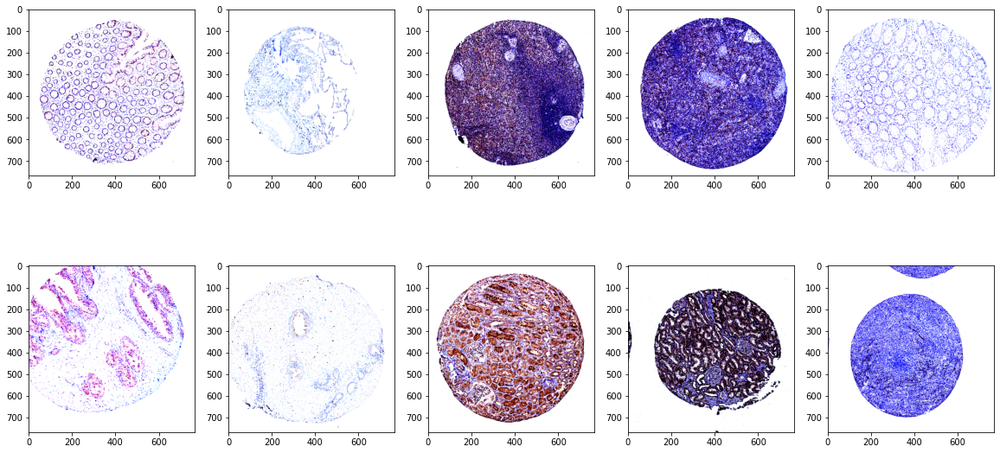

In [ ]:
# # # データセットのインスタンスを作成
train_dataset = Dataset(IMAGE_DIR, df[df['fold'] != 0].reset_index(), 
                        width=WIDTH, height=HEIGHT,
                        augmentation=get_training_augmentation3(), 
                        )

plt.figure(figsize=(20, 10))

print(train_dataset.__len__())
for i in range(10) :
  input = train_dataset[i]
  print(idx, input.pixel_values.shape)
  plt.subplot(2, 5, i+1);
  plt.imshow(input['pixel_values'].permute(1,2,0).numpy())
  # plt.imshow(input['labels'], alpha=0.5)
plt.show()

In [ ]:
from torch.utils.data import DataLoader
# CLASSES = ['car']


# データセットのインスタンスを作成
# train_dataset = Dataset(IMAGE_DIR, df[df['fold'] != FOLD].reset_index(), 
#                         width=WIDTH, height=HEIGHT,
#                         augmentation=get_training_augmentation3(p=0.9), 
#                         )
train_dataset = Dataset(IMAGE_DIR, df.reset_index(), 
                        width=WIDTH, height=HEIGHT,
                        augmentation=get_training_augmentation3(p=0.9), 
                        )

valid_dataset = Dataset(
    IMAGE_DIR, df[df['fold'] == FOLD].reset_index(), 
    width=WIDTH, height=HEIGHT,
    augmentation=None, 
)

# データローダーの作成
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

0


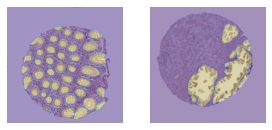

In [ ]:
row, col = 8, 8
plt.figure(figsize=(20,20))

for inputs in train_loader:
  print(idx)
  data = inputs['pixel_values']
  mask = inputs['labels']
  for i in range(BATCH_SIZE) :
    plt.subplot(col, row, i+1)
    x = data[i].permute(1,2,0)
    plt.imshow((x-x.min())/(x.max()-x.min()))
    plt.imshow(mask[i], alpha=0.3)
    plt.axis('off')
  # print(data.shape)
  break

## ここまで前処理

In [ ]:
from transformers import SegformerForSemanticSegmentation
# define model
model = SegformerForSemanticSegmentation.from_pretrained(MODEL_NAME,
                                                         num_labels=len(class2idx), 
                                                         id2label=idx2class, 
                                                         label2id=class2idx,
                                                         ignore_mismatched_sizes=True,
)

Downloading:   0%|          | 0.00/70.0k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/328M [00:00<?, ?B/s]

Some weights of the model checkpoint at nvidia/mit-b5 were not used when initializing SegformerForSemanticSegmentation: ['classifier.weight', 'classifier.bias']
- This IS expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b5 and are newly initialized: ['decode_head.batch_norm.running_mean', 'decode_head.linear_c.1.proj.bias', 'decode_head.linear_c.3.proj.bias', 'decode_head.linear_c.0.proj.bias', 'decode_head.linear_c.2.proj.bias', 'decode_head.bat

In [ ]:
# # model_path = '/content/drive/MyDrive/datas/HuBMAP/model.pth'
# model_path_last = '/content/drive/MyDrive/datas/HuBMAP/last-fold{}.pth'.format(FOLD)
# model_path_last = '/content/drive/MyDrive/datas/HuBMAP/model-b5-fold{}.pth'.format(FOLD)

# model.load_state_dict(torch.load(model_path_last))

In [ ]:
from datasets import load_metric

metric = load_metric("mean_iou")

In [ ]:
test_df = df[df['fold'] == FOLD].reset_index()

def dice_coef(mask1, mask2):
    intersect = np.sum(mask1*mask2)
    sum1 = np.sum(mask1)
    sum2 = np.sum(mask2)
    dice = 2*intersect/(sum1+sum2)
    dice = np.mean(dice)
    return dice

def valid(model2) :
  model2.eval()
  dice = 0.0
  loss = 0.0
  for i in tqdm(range(len(test_df))) :
    id = test_df.id[i]
    fname = "/content/hubmap/train_images/{}.tiff".format(id)
    image = Image.open(fname)
    encoding = feature_extractor(image, return_tensors="pt")
    pixel_values = encoding.pixel_values.cuda()

    # print(pixel_values.shape)

    organ = test_df.organ[i]
    idx = class2idx[organ]

    rle = test_df.rle[i]
    height, width = test_df.img_height[i], test_df.img_width[i]
    gt = rle2mask(rle, shape = (height, width))
    gt2 = cv2.resize(gt, pixel_values.shape[-2:]) * idx

    label = torch.tensor(gt2).unsqueeze(0).long().cuda()

    # print(label.shape)

    with torch.no_grad():
      outputs = model2(pixel_values=pixel_values, labels=label)
      loss += outputs.loss.item()
      # print(outputs.loss, loss)
      upsampled_logits = nn.functional.interpolate(outputs['logits'],
                  # size=image.size[::-1], # (height, width)
                  (height, width),
                  mode='bilinear',
                  align_corners=False)
      mask = upsampled_logits.argmax(dim=1)[0]
      mask[mask != idx] = 0
      mask[mask == idx] = 1


    dice += dice_coef(mask.cpu().numpy(), gt)
  return dice/len(test_df), loss/len(test_df)

In [ ]:
def read_model(file) :
  model = SegformerForSemanticSegmentation.from_pretrained(MODEL_NAME,
                                                          num_labels=len(class2idx), 
                                                          id2label=idx2class, 
                                                          label2id=class2idx,
                                                          ignore_mismatched_sizes=True,
  )
  model.load_state_dict(torch.load(file))
  model.cuda()
  model.eval()
  return model

def copy_params(model1, model2) :
  model1.load_state_dict(model2.state_dict())
  return model1

def sum_model_params(modelA, modelB):
    """ modelA + modelB """
    sdA = modelA.state_dict()
    sdB = modelB.state_dict()
    for key in sdA:
        sdA[key] = (sdA[key] + sdB[key])
    modelA.load_state_dict(sdA)
    return modelA

def multi_model_params(model, a):
    """ a * model """
    sd = model.state_dict()
    for key in sd:
        sd[key] = sd[key] * a
    model.load_state_dict(sd)
    return model

In [ ]:
# import torch
# from torch import nn
# from sklearn.metrics import accuracy_score
# # from tqdm.notebook import tqdm
# # from tqdm import tqdm
# from fastprogress.fastprogress import  progress_bar as tqdm

# from PIL import Image
# from transformers import SegformerFeatureExtractor

# feature_extractor = SegformerFeatureExtractor(reduce_labels=False, size=(WIDTH, HEIGHT))
# model = model.cuda()
# valid(model)

In [ ]:
# model_path_best = "/content/drive/MyDrive/datas/HuBMAP/merge-fold{}.pth".format(FOLD)
# model.load_state_dict(torch.load(model_path_best))

# model.load_state_dict(torch.load("/content/drive/MyDrive/datas/HuBmap-segformer/epoch250-fold1.pth"))

In [ ]:
import copy
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

best_model = copy.deepcopy(model)
best_model.to(device)
best_model.eval()

tmp_model = copy.deepcopy(model).to(device).eval()

## TRAIN


In [ ]:
import random

import torch
from torch import nn
from sklearn.metrics import accuracy_score
# from tqdm.notebook import tqdm
# from tqdm import tqdm
from fastprogress.fastprogress import  progress_bar as tqdm

from PIL import Image
from transformers import SegformerFeatureExtractor

writer = SummaryWriter(log_dir="./logs")
feature_extractor = SegformerFeatureExtractor(reduce_labels=False, size=(WIDTH, HEIGHT))
use_amp = True # ampをオンオフ


# define optimizer
# optimizer = torch.optim.AdamW(model.parameters(), lr=0.00006)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4,  weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size = 50, gamma=0.9)

# move model to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

scaler = torch.cuda.amp.GradScaler(enabled=use_amp)

# scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, 
#                                               base_lr=1e-5,
#                                               max_lr=1e-3,
#                                               step_size_up=20,
#                                               step_size_down=30,
#                                               mode="triangular2",
#                                               cycle_momentum=False,
#                                               gamma=0.95)


model.train()
print("best model")
cur_loss,_ = valid(best_model)
print("dice = ", cur_loss)
best_epoch = 0
for epoch in range(200):  # loop over the dataset multiple times
   print("Epoch:", epoch)
   
   model.train()
   optimizer.zero_grad()

   tot_loss = 0.0
   for idx, batch in enumerate(tqdm(train_loader)):
        # get the inputs;
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        # print(pixel_values.shape, labels.shape)

        # zero the parameter gradients
        with torch.cuda.amp.autocast(enabled=use_amp):
            # forward + backward + optimize
            outputs = model(pixel_values=pixel_values, labels=labels)
            loss, logits = outputs.loss, outputs.logits

        tot_loss += loss.detach().cpu().numpy()
        
        scaler.scale(loss).backward()

        if (idx + 1) % Gradient_Accumulation_Step == 0 or idx == len(train_loader) :
            # optimizer.step()
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()

   scheduler.step()

   print("Loss:", tot_loss/len(train_loader))

   print("valid...")

   dice,valid_loss = valid(model)

   writer.add_scalars("loss", {
       "train": tot_loss/len(train_loader),
       "valid": valid_loss,
       }, epoch+1)  
   writer.add_scalar("lr", scheduler.get_last_lr()[0], epoch+1)
   
   if dice > cur_loss :
     cur_loss = dice
     best_epoch = epoch
     print("update best dice = ", dice, "loss = ", valid_loss)
     torch.save(model.state_dict(), model_path)
     best_model = copy_params(best_model, model)
  #  elif random.random() >= 0.5:
  #    tmp_model = copy_params(tmp_model, best_model)
  #    tmp_model = sum_model_params(tmp_model, model)
  #    tmp_model = multi_model_params(tmp_model, 1/2)
  #    tmp_dice, tmp_valid_loss = valid(tmp_model)
  #    print("dice = ", dice , "tmp = ", tmp_dice, "best = ", cur_loss)
  #    if tmp_dice > cur_loss :
  #       cur_loss = tmp_dice
  #       best_epoch = epoch
  #       model = copy_params(model, tmp_model)
  #       best_model = copy_params(best_model, model)
  #       print("update best dice = ", tmp_dice, "loss = ", tmp_valid_loss, "best <- tmp_model")
  #       torch.save(model.state_dict(), model_path)  
  #    else:
  #      if tmp_dice > dice :
  #        model = copy_params(model, tmp_model)
  #        print("epoch dice = ", tmp_dice, "loss = ", tmp_valid_loss, "model <- tmp_model")
  #      else:
  #        print("epoch dice = ", dice, "loss = ", valid_loss)
   else :
         print("epoch dice = ", dice, "loss = ", valid_loss, "p<0.5")

   if epoch >= 100 and epoch%50 == 0 :
      model_path_last = '/content/drive/MyDrive/datas/HuBmap-segformer/epoch{}-fold{}.pth'.format(epoch, FOLD)
      torch.save(model.state_dict(), model_path_last)
         
   wandb.log({'epoch': epoch, 'train_loss': tot_loss/len(train_loader), "valid_loss": valid_loss, 
              "dice": dice, "lr":scheduler.get_last_lr()[0], "best dice": cur_loss, "best epoch": best_epoch})


writer.close()
wandb.save(model_path)

best model


dice =  0.101720903478157
Epoch: 0


Loss: 1.2953487505966967
valid...


update best dice =  0.5611827236321211 loss =  0.7952201873318762
Epoch: 1


Loss: 0.5958546628667549
valid...


update best dice =  0.6275029467649957 loss =  0.3578010381032259
Epoch: 2


Loss: 0.3663513391194018
valid...


update best dice =  0.6693818012790826 loss =  0.23596248361799452
Epoch: 3


Loss: 0.2683445196598768
valid...


update best dice =  0.689054925969586 loss =  0.19512305287723866
Epoch: 4


Loss: 0.22078706650063396
valid...


update best dice =  0.6936722084724809 loss =  0.15766711545805645
Epoch: 5


Loss: 0.18919914876195518
valid...


update best dice =  0.7125702662078013 loss =  0.14044938016778383
Epoch: 6


Loss: 0.17251514220102268
valid...


update best dice =  0.7219321718168928 loss =  0.14007895767816111
Epoch: 7


Loss: 0.15265794860368426
valid...


epoch dice =  0.7100096653067034 loss =  0.13205478384963468 p<0.5
Epoch: 8


Loss: 0.1430484861643477
valid...


update best dice =  0.7317874121304476 loss =  0.10752845977425066
Epoch: 9


Loss: 0.1262595090083778
valid...


update best dice =  0.7369443630961433 loss =  0.09698294930987889
Epoch: 10


Loss: 0.11865816997702826
valid...


epoch dice =  0.7308048635563503 loss =  0.09594485900786698 p<0.5
Epoch: 11


Loss: 0.11784236152148382
valid...


update best dice =  0.7452540814594871 loss =  0.09368784439105254
Epoch: 12


Loss: 0.11040192122825167
valid...


epoch dice =  0.7449650347245758 loss =  0.09954271322259536 p<0.5
Epoch: 13


Loss: 0.1036506795366718
valid...


update best dice =  0.75376650298328 loss =  0.09006351880474478
Epoch: 14


Loss: 0.1015739895890213
valid...


epoch dice =  0.7497308577435494 loss =  0.0930325707150066 p<0.5
Epoch: 15


Loss: 0.0938379632901739
valid...


update best dice =  0.7539788128182248 loss =  0.09666815751956569
Epoch: 16


Loss: 0.08771533694710922
valid...


update best dice =  0.7642528074949659 loss =  0.07717562844960862
Epoch: 17


Loss: 0.08617461015554992
valid...


update best dice =  0.7700469275127608 loss =  0.07361733386468174
Epoch: 18


Loss: 0.08523341658821498
valid...


update best dice =  0.7812491191042904 loss =  0.07837686020658056
Epoch: 19


Loss: 0.08269067584875632
valid...


update best dice =  0.7853554632942776 loss =  0.07509622809628391
Epoch: 20


Loss: 0.08165674387816
valid...


epoch dice =  0.7797332698636135 loss =  0.08849220579633346 p<0.5
Epoch: 21


Loss: 0.07739630337296562
valid...


update best dice =  0.8026872860455295 loss =  0.07370421396265937
Epoch: 22


Loss: 0.07206409397027032
valid...


update best dice =  0.8066485359460694 loss =  0.07316216579678221
Epoch: 23


Loss: 0.0722123701654544
valid...


update best dice =  0.8235488671910377 loss =  0.06847818073235516
Epoch: 24


Loss: 0.07168623295464469
valid...


epoch dice =  0.8124393634115296 loss =  0.06648122191301778 p<0.5
Epoch: 25


Loss: 0.07082295817831023
valid...


epoch dice =  0.80210894865792 loss =  0.05974447782923523 p<0.5
Epoch: 26


Loss: 0.06638375960226933
valid...


update best dice =  0.8246136824162528 loss =  0.07374050206321682
Epoch: 27


Loss: 0.06482251715020869
valid...


update best dice =  0.8246611867728396 loss =  0.06290014398594697
Epoch: 28


Loss: 0.06394883409798653
valid...


update best dice =  0.8247097697741363 loss =  0.05662537589430427
Epoch: 29


Loss: 0.06280200420984659
valid...


update best dice =  0.8250156722583154 loss =  0.062104185406341515
Epoch: 30


Loss: 0.0649393506993709
valid...


epoch dice =  0.8100081822003004 loss =  0.05384293847725305 p<0.5
Epoch: 31


Loss: 0.07148995885985311
valid...


epoch dice =  0.8080143274411421 loss =  0.05258209629254973 p<0.5
Epoch: 32


Loss: 0.06840497711990876
valid...


epoch dice =  0.8207024139499725 loss =  0.07333315313897198 p<0.5
Epoch: 33


Loss: 0.0660667712006464
valid...


update best dice =  0.8348600753679611 loss =  0.062242918870706335
Epoch: 34


Loss: 0.06238726112166081
valid...


epoch dice =  0.8232283414875888 loss =  0.05959579499406565 p<0.5
Epoch: 35


Loss: 0.061556304132946854
valid...


epoch dice =  0.827512719859618 loss =  0.05369563390397363 p<0.5
Epoch: 36


Loss: 0.06132256403692405
valid...


epoch dice =  0.8215672559078694 loss =  0.050915444699617535 p<0.5
Epoch: 37


Loss: 0.055769267899449915
valid...


update best dice =  0.8441602942253943 loss =  0.053554056415286586
Epoch: 38


Loss: 0.056132056374653155
valid...


epoch dice =  0.8416746544932201 loss =  0.048213695080425494 p<0.5
Epoch: 39


Loss: 0.0550681421988305
valid...


epoch dice =  0.8422964444738549 loss =  0.05485995257130036 p<0.5
Epoch: 40


Loss: 0.05462773531590673
valid...


update best dice =  0.8533385721638563 loss =  0.05430223669809026
Epoch: 41


Loss: 0.05449658531737937
valid...


epoch dice =  0.8422907109105295 loss =  0.04711840649207051 p<0.5
Epoch: 42


Loss: 0.052077485179655596
valid...


epoch dice =  0.8462940936451377 loss =  0.05260797164554142 p<0.5
Epoch: 43


Loss: 0.05258240458153358
valid...


update best dice =  0.8566291213775605 loss =  0.04594691094950351
Epoch: 44


Loss: 0.04931158158102666
valid...


update best dice =  0.8600836472660147 loss =  0.04789728027346552
Epoch: 45


Loss: 0.05092838044616987
valid...


update best dice =  0.8601739697999341 loss =  0.047690705022113956
Epoch: 46


Loss: 0.049288343945094806
valid...


update best dice =  0.8708985427570414 loss =  0.04260509803644421
Epoch: 47


Loss: 0.05098821552978321
valid...


epoch dice =  0.854877461799106 loss =  0.053705286795798786 p<0.5
Epoch: 48


Loss: 0.05063644376720979
valid...


epoch dice =  0.8408774356237441 loss =  0.05557525501801418 p<0.5
Epoch: 49


Loss: 0.04835900191259994
valid...


epoch dice =  0.8641794959529103 loss =  0.04768739488278317 p<0.5
Epoch: 50


Loss: 0.04607384836576371
valid...


epoch dice =  0.8659193518081847 loss =  0.04182645853640687 p<0.5
Epoch: 51


Loss: 0.0466700351733545
valid...


epoch dice =  0.8630287472915567 loss =  0.05137209225302705 p<0.5
Epoch: 52


Loss: 0.04504840789278122
valid...


update best dice =  0.8718726288907005 loss =  0.04730053400246697
Epoch: 53


Loss: 0.04491795065802184
valid...


update best dice =  0.8718905859152747 loss =  0.04949985511807932
Epoch: 54


Loss: 0.04502399774554016
valid...


epoch dice =  0.8710241829520908 loss =  0.04210405081956305 p<0.5
Epoch: 55


Loss: 0.044306382891425695
valid...


update best dice =  0.8784427162942114 loss =  0.04296142874986061
Epoch: 56


Loss: 0.04407039220677689
valid...


epoch dice =  0.8749454574233475 loss =  0.03965056403619675 p<0.5
Epoch: 57


Loss: 0.04254926815734838
valid...


epoch dice =  0.8754588148467235 loss =  0.040455287167181574 p<0.5
Epoch: 58


Loss: 0.0442703748465812
valid...


update best dice =  0.8835474264404131 loss =  0.040039317805765785
Epoch: 59


Loss: 0.04356742424318905
valid...


epoch dice =  0.8779772125702852 loss =  0.04202698714211265 p<0.5
Epoch: 60


Loss: 0.044165650999110025
valid...


update best dice =  0.8841557756125308 loss =  0.03976364598338866
Epoch: 61


Loss: 0.04283362523578531
valid...


epoch dice =  0.8799804924648399 loss =  0.04119883219186121 p<0.5
Epoch: 62


Loss: 0.04209848978313279
valid...


epoch dice =  0.8792775911049386 loss =  0.0400250521587988 p<0.5
Epoch: 63


Loss: 0.04248843943721361
valid...


epoch dice =  0.8802210820537006 loss =  0.041102153374455296 p<0.5
Epoch: 64


Loss: 0.04072145556512458
valid...


epoch dice =  0.8781831971553842 loss =  0.04172815659887388 p<0.5
Epoch: 65


Loss: 0.04212862596349706
valid...


epoch dice =  0.8745062754201908 loss =  0.04190252753547751 p<0.5
Epoch: 66


Loss: 0.042160546600247144
valid...


epoch dice =  0.8828420720846433 loss =  0.043860494350202575 p<0.5
Epoch: 67


Loss: 0.041829741012241524
valid...


update best dice =  0.8898048454809997 loss =  0.03733902318904606
Epoch: 68


Loss: 0.04211846032359807
valid...


epoch dice =  0.8828150214205127 loss =  0.03942025429768185 p<0.5
Epoch: 69


Loss: 0.040301316846373746
valid...


epoch dice =  0.8863540939559732 loss =  0.03664239704943238 p<0.5
Epoch: 70


Loss: 0.03869013496759263
valid...


epoch dice =  0.8869493108820138 loss =  0.03819847869901703 p<0.5
Epoch: 71


Loss: 0.0384554885677062
valid...


update best dice =  0.8923801562828696 loss =  0.035421098727716975
Epoch: 72


Loss: 0.03908419049482539
valid...


epoch dice =  0.8882393675948426 loss =  0.03689472186856736 p<0.5
Epoch: 73


Loss: 0.03806343246833421
valid...


update best dice =  0.8932598649620594 loss =  0.03380961721946095
Epoch: 74


Loss: 0.03768462852564302
valid...


update best dice =  0.8944400546351391 loss =  0.03218331422784135
Epoch: 75


Loss: 0.037757564804368565
valid...


epoch dice =  0.8937567169332681 loss =  0.03226944134156737 p<0.5
Epoch: 76


Loss: 0.03689994278829545
valid...


update best dice =  0.901790043803892 loss =  0.03347600175418023
Epoch: 77


Loss: 0.03669497272031466
valid...


epoch dice =  0.8963597469786824 loss =  0.033649367105183944 p<0.5
Epoch: 78


Loss: 0.03688764779574492
valid...


epoch dice =  0.8962387969731893 loss =  0.03426718307284909 p<0.5
Epoch: 79


Loss: 0.036022031991954216
valid...


epoch dice =  0.8945004968191634 loss =  0.03416541323033918 p<0.5
Epoch: 80


Loss: 0.036965677779252554
valid...


epoch dice =  0.8999978514837016 loss =  0.033228091748319886 p<0.5
Epoch: 81


Loss: 0.037603514017643065
valid...


epoch dice =  0.8903959878156629 loss =  0.03795729460529028 p<0.5
Epoch: 82


Loss: 0.036910998621765015
valid...


epoch dice =  0.9008189457141595 loss =  0.03399131160516005 p<0.5
Epoch: 83


Loss: 0.037081171041460366
valid...


epoch dice =  0.8987356832592559 loss =  0.03309606692284091 p<0.5
Epoch: 84


Loss: 0.03517556929992596
valid...


update best dice =  0.9024317417393384 loss =  0.03244218576508455
Epoch: 85


Loss: 0.03650813528061421
valid...


epoch dice =  0.8949112267813732 loss =  0.03475230572044722 p<0.5
Epoch: 86


Loss: 0.03651635494315997
valid...


epoch dice =  0.8990918511923829 loss =  0.03401763376612694 p<0.5
Epoch: 87


Loss: 0.03527997787486212
valid...


update best dice =  0.9040459887328759 loss =  0.03144829208031297
Epoch: 88


Loss: 0.035244557353011755
valid...


update best dice =  0.9077638629450113 loss =  0.03198813333008916
Epoch: 89


Loss: 0.035102506587546406
valid...


epoch dice =  0.9042163225870478 loss =  0.032136663804467544 p<0.5
Epoch: 90


Loss: 0.03407412076591176
valid...


epoch dice =  0.9051599352598784 loss =  0.03050503252734804 p<0.5
Epoch: 91


Loss: 0.03307070940023881
valid...


epoch dice =  0.9065500880480603 loss =  0.03263471617649954 p<0.5
Epoch: 92


Loss: 0.03320291256055829
valid...


epoch dice =  0.9076577395663513 loss =  0.030289006737880726 p<0.5
Epoch: 93


Loss: 0.033766917267877776
valid...


update best dice =  0.9084007840613214 loss =  0.029522582333391674
Epoch: 94


Loss: 0.03290834981387227
valid...


update best dice =  0.9113432365872144 loss =  0.030299082064093687
Epoch: 95


Loss: 0.033659864267313176
valid...


update best dice =  0.9122611456861106 loss =  0.03047698162870211
Epoch: 96


Loss: 0.033864364586241376
valid...


epoch dice =  0.9062840181534637 loss =  0.03162324630941909 p<0.5
Epoch: 97


Loss: 0.03366022258441345
valid...


epoch dice =  0.9005267034358012 loss =  0.034702646679396175 p<0.5
Epoch: 98


Loss: 0.033603748747158206
valid...


epoch dice =  0.9063162498793181 loss =  0.032418296590813585 p<0.5
Epoch: 99


Loss: 0.03293840489244427
valid...


update best dice =  0.9140471159103136 loss =  0.031100722280545876
Epoch: 100


Loss: 0.032288779081268745
valid...


update best dice =  0.9142911321397685 loss =  0.030059509439011797
Epoch: 101


Loss: 0.03252452333584766
valid...


update best dice =  0.9169877207148721 loss =  0.030871415801314462
Epoch: 102


Loss: 0.03204545092673718
valid...


update best dice =  0.9175000810769686 loss =  0.030363970173475068
Epoch: 103


Loss: 0.03208851939813361
valid...


update best dice =  0.9182723263422167 loss =  0.028361178025141612
Epoch: 104


Loss: 0.0328876013412479
valid...


epoch dice =  0.9145418041552753 loss =  0.0288480910528292 p<0.5
Epoch: 105


Loss: 0.03292429096605205
valid...


epoch dice =  0.9119995527740495 loss =  0.030606549848109867 p<0.5
Epoch: 106


Loss: 0.03192929546772079
valid...


update best dice =  0.9187467490019001 loss =  0.02904935499143779
Epoch: 107


Loss: 0.03202532788881482
valid...


epoch dice =  0.9182240292675836 loss =  0.02821792513490296 p<0.5
Epoch: 108


Loss: 0.03133224344955207
valid...


epoch dice =  0.9134678446722357 loss =  0.027990106755915362 p<0.5
Epoch: 109


Loss: 0.033301551805131814
valid...


update best dice =  0.9188945633420429 loss =  0.0293764614730946
Epoch: 110


Loss: 0.03553668058487925
valid...


epoch dice =  0.909038843350419 loss =  0.0319478007642409 p<0.5
Epoch: 111


Loss: 0.03373832327567718
valid...


epoch dice =  0.9090388467576406 loss =  0.036849054048219934 p<0.5
Epoch: 112


Loss: 0.03305581207016737
valid...


epoch dice =  0.9127200561439902 loss =  0.031323401358886026 p<0.5
Epoch: 113


Loss: 0.03345447446653535
valid...


epoch dice =  0.9086182457901814 loss =  0.028574931638267558 p<0.5
Epoch: 114


Loss: 0.03394548335266088
valid...


epoch dice =  0.9179911320489347 loss =  0.02951266019183219 p<0.5
Epoch: 115


Loss: 0.0407684381776066
valid...


epoch dice =  0.915360788610754 loss =  0.028799939303635023 p<0.5
Epoch: 116


Loss: 0.036356848056047136
valid...


epoch dice =  0.895337699231159 loss =  0.03929977789202817 p<0.5
Epoch: 117


Loss: 0.036177071269114756
valid...


epoch dice =  0.9139777712442879 loss =  0.03100032419658815 p<0.5
Epoch: 118


Loss: 0.03321135112624192
valid...


epoch dice =  0.9063352491342156 loss =  0.03033729846903688 p<0.5
Epoch: 119


Loss: 0.03277889118577481
valid...


update best dice =  0.9201555960559273 loss =  0.02924279111206659
Epoch: 120


Loss: 0.03172442283936438
valid...


update best dice =  0.920166437055442 loss =  0.028647244319868967
Epoch: 121


Loss: 0.03190629874536006
valid...


epoch dice =  0.9151673804055591 loss =  0.029374410805260587 p<0.5
Epoch: 122


Loss: 0.03114057911443524
valid...


update best dice =  0.9228607174643534 loss =  0.029077512522538502
Epoch: 123


Loss: 0.030516311702244406
valid...


update best dice =  0.9275251783077476 loss =  0.02771942781754093
Epoch: 124


Loss: 0.03048862331938422
valid...


update best dice =  0.9281056872678443 loss =  0.026829329647649176
Epoch: 125


Loss: 0.030936053911732
valid...


epoch dice =  0.9261119529526771 loss =  0.027553918598315272 p<0.5
Epoch: 126


Loss: 0.02960702955235981
valid...


epoch dice =  0.921191286504805 loss =  0.0284394665599331 p<0.5
Epoch: 127


Loss: 0.029666077492451717
valid...


epoch dice =  0.9244693348739007 loss =  0.0261873083614991 p<0.5
Epoch: 128


Loss: 0.029800429989171043
valid...


epoch dice =  0.9261360211801505 loss =  0.027826048283535253 p<0.5
Epoch: 129


Loss: 0.029344743003920568
valid...


update best dice =  0.9282985123384618 loss =  0.026875785210679293
Epoch: 130


Loss: 0.02977832178294193
valid...


update best dice =  0.9287035162791485 loss =  0.025921198104619663
Epoch: 131


Loss: 0.029097759860715913
valid...


epoch dice =  0.9262095651449822 loss =  0.025657658124915682 p<0.5
Epoch: 132


Loss: 0.02913064206553496
valid...


update best dice =  0.9289426024316043 loss =  0.025921711418578703
Epoch: 133


Loss: 0.0287388675020669
valid...


update best dice =  0.9299291663897196 loss =  0.02617359473409816
Epoch: 134


Loss: 0.029186217320701955
valid...


epoch dice =  0.929739771367375 loss =  0.025147791270317875 p<0.5
Epoch: 135


Loss: 0.02879422117786651
valid...


epoch dice =  0.9273540716847326 loss =  0.025908775433587532 p<0.5
Epoch: 136


Loss: 0.029354413852243768
valid...


update best dice =  0.9346803797704997 loss =  0.025410335033367842
Epoch: 137


Loss: 0.028315383387962356
valid...


epoch dice =  0.9326728251573767 loss =  0.024741461902506586 p<0.5
Epoch: 138


Loss: 0.028141803823845377
valid...


epoch dice =  0.9336824336451214 loss =  0.024692699547984406 p<0.5
Epoch: 139


Loss: 0.028321604196786542
valid...


epoch dice =  0.9322215769889148 loss =  0.02514213025291315 p<0.5
Epoch: 140


Loss: 0.027824691565580328
valid...


epoch dice =  0.9320686457441357 loss =  0.024462623530640625 p<0.5
Epoch: 141


Loss: 0.0274876785247629
valid...


epoch dice =  0.9324771477666769 loss =  0.024252666195289384 p<0.5
Epoch: 142


Loss: 0.027619721233019267
valid...


epoch dice =  0.9332967900640035 loss =  0.02615901099271181 p<0.5
Epoch: 143


Loss: 0.0279557456378825
valid...


epoch dice =  0.9337459839659922 loss =  0.025120291979306847 p<0.5
Epoch: 144


Loss: 0.027616077883232556
valid...


update best dice =  0.9358819496987997 loss =  0.024945034467392307
Epoch: 145


Loss: 0.027549255319172516
valid...


epoch dice =  0.9344727290141475 loss =  0.025076023819378745 p<0.5
Epoch: 146


Loss: 0.02717356489368037
valid...


epoch dice =  0.9316475140379701 loss =  0.025617629131421637 p<0.5
Epoch: 147


Loss: 0.028219143239601344
valid...


epoch dice =  0.9218800362937916 loss =  0.026250443290958866 p<0.5
Epoch: 148


Loss: 0.02868388773905198
valid...


epoch dice =  0.9240987316930294 loss =  0.027099400349797156 p<0.5
Epoch: 149


Loss: 0.02846908611933362
valid...


epoch dice =  0.9299259255571337 loss =  0.02542324549952347 p<0.5
Epoch: 150


Loss: 0.0279114127690925
valid...


epoch dice =  0.9348344675981028 loss =  0.02490401499443011 p<0.5
Epoch: 151


Loss: 0.02797656442006965
valid...


epoch dice =  0.9347682963491724 loss =  0.02462558616967633 p<0.5
Epoch: 152


Loss: 0.026889290601089175
valid...


update best dice =  0.9367007047043798 loss =  0.02432434586211084
Epoch: 153


Loss: 0.027236225551777436
valid...


epoch dice =  0.9357458686573386 loss =  0.024739876554673936 p<0.5
Epoch: 154


Loss: 0.027027119960455984
valid...


update best dice =  0.9371407609096066 loss =  0.023209519527104292
Epoch: 155


Loss: 0.026769232606801033
valid...


epoch dice =  0.9360989961065818 loss =  0.024277670070146903 p<0.5
Epoch: 156


Loss: 0.02652939674788451
valid...


update best dice =  0.9397341282012669 loss =  0.02314931656528487
Epoch: 157


Loss: 0.026961408928565852
valid...


epoch dice =  0.9366400117915583 loss =  0.023295990636166282 p<0.5
Epoch: 158


Loss: 0.026920282674836926
valid...


epoch dice =  0.9387716744627651 loss =  0.024286301955819514 p<0.5
Epoch: 159


Loss: 0.026636369888199788
valid...


epoch dice =  0.9357258992391883 loss =  0.024739951466441028 p<0.5
Epoch: 160


Loss: 0.02669158943436659
valid...


epoch dice =  0.9382119012834567 loss =  0.024364177676904786 p<0.5
Epoch: 161


Loss: 0.02653771411066621
valid...


epoch dice =  0.9396206423515814 loss =  0.02425327052613004 p<0.5
Epoch: 162


Loss: 0.026692534870976073
valid...


epoch dice =  0.9387778330210981 loss =  0.02439414909403994 p<0.5
Epoch: 163


Loss: 0.026970694415715778
valid...


epoch dice =  0.9358642951728113 loss =  0.024040413991564043 p<0.5
Epoch: 164


Loss: 0.026556492867794903
valid...


epoch dice =  0.9396187948979648 loss =  0.022764075849937577 p<0.5
Epoch: 165


Loss: 0.0257612996382787
valid...


update best dice =  0.9401861933538549 loss =  0.022792795890918337
Epoch: 166


Loss: 0.026142995690778745
valid...


epoch dice =  0.9400312465553832 loss =  0.022793888945220053 p<0.5
Epoch: 167


Loss: 0.025897822341490115
valid...


epoch dice =  0.938899682274048 loss =  0.0234870210600396 p<0.5
Epoch: 168


Loss: 0.025700863761647433
valid...


epoch dice =  0.9393606367494746 loss =  0.023121293439155716 p<0.5
Epoch: 169


Loss: 0.026463684447993397
valid...


epoch dice =  0.9395618075810929 loss =  0.023594155710620377 p<0.5
Epoch: 170


Loss: 0.026421820672112517
valid...


epoch dice =  0.9390812086359012 loss =  0.02370968898738392 p<0.5
Epoch: 171


Loss: 0.0261411146864041
valid...


epoch dice =  0.9387656742067569 loss =  0.02323436551592034 p<0.5
Epoch: 172


Loss: 0.02625599073441911
valid...


update best dice =  0.9404053644601238 loss =  0.023391765866699256
Epoch: 173


Loss: 0.025578585018096914
valid...


epoch dice =  0.939453182305986 loss =  0.023428814629944533 p<0.5
Epoch: 174


Loss: 0.025291029759418136
valid...


update best dice =  0.941071789818335 loss =  0.022656911299524143
Epoch: 175


Loss: 0.025849397187068298
valid...


update best dice =  0.9422474712651735 loss =  0.02232611819735577
Epoch: 176


Loss: 0.02494572272884067
valid...


update best dice =  0.9432943103769617 loss =  0.02217465505684511
Epoch: 177


Loss: 0.025376259519940835
valid...


epoch dice =  0.941774790319398 loss =  0.022154998201399278 p<0.5
Epoch: 178


Loss: 0.02486601417397403
valid...


epoch dice =  0.9427848186114655 loss =  0.02236179781691609 p<0.5
Epoch: 179


Loss: 0.025434356241021305
valid...


epoch dice =  0.9419721509956558 loss =  0.022435354501701508 p<0.5
Epoch: 180


Loss: 0.02508092388135
valid...


epoch dice =  0.9415020829685093 loss =  0.022163866919616602 p<0.5
Epoch: 181


Loss: 0.02447376920132559
valid...


epoch dice =  0.9429755377363667 loss =  0.022016144073050883 p<0.5
Epoch: 182


Loss: 0.02552604156451046
valid...


epoch dice =  0.9416606258360483 loss =  0.022944092344588194 p<0.5
Epoch: 183


Loss: 0.025338313505265185
valid...


epoch dice =  0.9401928114908521 loss =  0.02333739954823007 p<0.5
Epoch: 184


Loss: 0.0252008036212911
valid...


epoch dice =  0.9399254446747602 loss =  0.023372946008562278 p<0.5
Epoch: 185


Loss: 0.025574687736728018
valid...


epoch dice =  0.9419273879226955 loss =  0.023242754628881812 p<0.5
Epoch: 186


Loss: 0.025544424960654313
valid...


epoch dice =  0.9424266243253353 loss =  0.022576511589786373 p<0.5
Epoch: 187


Loss: 0.025027132845769465
valid...


epoch dice =  0.9396944596010117 loss =  0.022238609576040607 p<0.5
Epoch: 188


Loss: 0.025010206110891886
valid...


epoch dice =  0.940945653885298 loss =  0.021983129144487027 p<0.5
Epoch: 189


Loss: 0.024537446943048217
valid...


update best dice =  0.9445078475412675 loss =  0.021512711700251024
Epoch: 190


Loss: 0.024349853238990447
valid...


epoch dice =  0.9410495388477645 loss =  0.023484198751652405 p<0.5
Epoch: 191


Loss: 0.02459213892606468
valid...


epoch dice =  0.9442978334646582 loss =  0.021549873078902625 p<0.5
Epoch: 192


Loss: 0.024258960009319708
valid...


epoch dice =  0.9441925932039869 loss =  0.0215357978694921 p<0.5
Epoch: 193


Loss: 0.02466451220574196
valid...


epoch dice =  0.9398165411349362 loss =  0.022405501746604394 p<0.5
Epoch: 194


Loss: 0.02447639980395748
valid...


epoch dice =  0.9444146870542176 loss =  0.021499166022349372 p<0.5
Epoch: 195


Loss: 0.024278304939798545
valid...


epoch dice =  0.9439898949989419 loss =  0.02240863643312015 p<0.5
Epoch: 196


Loss: 0.02428976986133917
valid...


update best dice =  0.9456091790421186 loss =  0.021118366856000617
Epoch: 197


Loss: 0.02373569765371609
valid...


epoch dice =  0.9435346946043548 loss =  0.022283929912572425 p<0.5
Epoch: 198


Loss: 0.0235393471917963
valid...


epoch dice =  0.9455897236999048 loss =  0.021379206122623548 p<0.5
Epoch: 199


Loss: 0.024304934953265314
valid...


update best dice =  0.9465306166580368 loss =  0.02131726631186266


wandb: WARNING Saving files without folders. If you want to preserve sub directories pass base_path to wandb.save, i.e. wandb.save("/mnt/folder/file.h5", base_path="/mnt")


['/content/wandb/run-20220914_223639-3ojed2vu/files/model-b5-fold0.pth']

In [ ]:
model_path_last = '/content/drive/MyDrive/datas/HuBMAP/last-fold{}.pth'.format(FOLD)
torch.save(model.state_dict(), model_path_last)
wandb.save(model_path_last)

wandb: WARNING Saving files without folders. If you want to preserve sub directories pass base_path to wandb.save, i.e. wandb.save("/mnt/folder/file.h5", base_path="/mnt")


['/content/wandb/run-20220914_223639-3ojed2vu/files/last-fold0.pth']

In [ ]:
%tensorboard --logdir ./logs

<IPython.core.display.Javascript object>

In [ ]:
# from transformers import SegformerForSemanticSegmentation
# # define model
# model = SegformerForSemanticSegmentation.from_pretrained("nvidia/mit-b3",
#                                                          num_labels=len(class2idx), 
#                                                          id2label=idx2class, 
#                                                          label2id=class2idx,
# )

In [ ]:
# model2 = SegformerForSemanticSegmentation(model.config)
# model_path = '/content/drive/MyDrive/datas/HuBMAP/model.pth'
# model2.load_state_dict(torch.load(model_path))
# model2 = model2.cuda()

In [ ]:
# from PIL import Image
# image = Image.open('/content/hubmap/train_images/10044.tiff')
# plt.imshow(image)

In [ ]:
# from transformers import SegformerFeatureExtractor
# feature_extractor = SegformerFeatureExtractor(reduce_labels=False)

# encoding = feature_extractor(image, return_tensors="pt")
# pixel_values = encoding.pixel_values.cuda()
# print(pixel_values.shape)

In [ ]:
# # forward pass
# outputs = model2(pixel_values=pixel_values)

In [ ]:
# logits = outputs.logits.cpu()
# print(logits.shape)

In [ ]:
# def ade_palette():
#     """ADE20K palette that maps each class to RGB values."""
#     return [[120, 120, 120], [180, 120, 120], [6, 230, 230], [80, 50, 50],
#             [4, 200, 3], [120, 120, 80], [140, 140, 140], [204, 5, 255]]

In [ ]:
# from torch import nn
# import numpy as np
# import matplotlib.pyplot as plt

# # First, rescale logits to original image size
# upsampled_logits = nn.functional.interpolate(logits,
#                 size=image.size[::-1], # (height, width)
#                 mode='bilinear',
#                 align_corners=False)

# # Second, apply argmax on the class dimension
# seg = upsampled_logits.argmax(dim=1)[0]
# color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3
# palette = np.array(ade_palette())
# for label, color in enumerate(palette):
#     color_seg[seg == label, :] = color
# # Convert to BGR
# color_seg = color_seg[..., ::-1]

# # Show image + mask
# img = np.array(image) * 0.5 + color_seg * 0.5
# img = img.astype(np.uint8)

# plt.figure(figsize=(15, 10))
# plt.imshow(img)
# plt.show()

# inference

In [ ]:
def dice_coef(mask1, mask2):
    intersect = np.sum(mask1*mask2)
    sum1 = np.sum(mask1)
    sum2 = np.sum(mask2)
    dice = 2*intersect/(sum1+sum2)
    dice = np.mean(dice)
    return dice


In [ ]:
from transformers import SegformerForSemanticSegmentation
from transformers import SegformerModel, SegformerConfig

# define model
# model = SegformerForSemanticSegmentation.from_pretrained(MODEL_NAME,
#                                                          num_labels=len(class2idx), 
#                                                          id2label=idx2class, 
#                                                          label2id=class2idx,
# )


config = SegformerConfig.from_pretrained(MODEL_NAME,
                        num_labels=len(class2idx), 
                        id2label=idx2class, 
                        label2id=class2idx,
                        ignore_mismatched_sizes=True,
)

model2 = SegformerForSemanticSegmentation(config)
# model_path = '/content/drive/MyDrive/datas/HuBMAP/model-sub3-fold{}.pth'.format(FOLD)
model2.load_state_dict(torch.load(model_path))
model2 = model2.cuda()

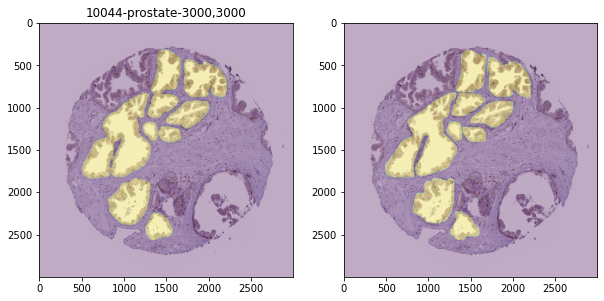

0.9493884016091668 0.9493884016091668


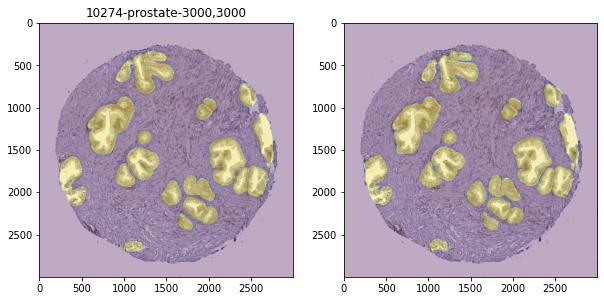

0.9570478749552823 0.9532181382822246


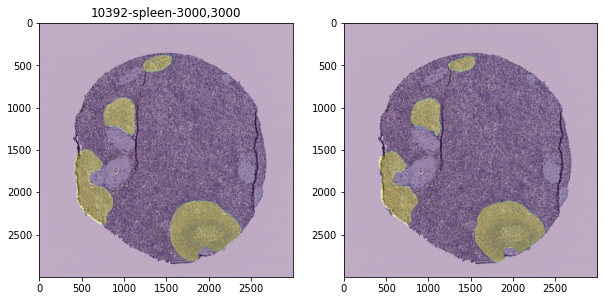

0.9592943943647945 0.9552435569764146


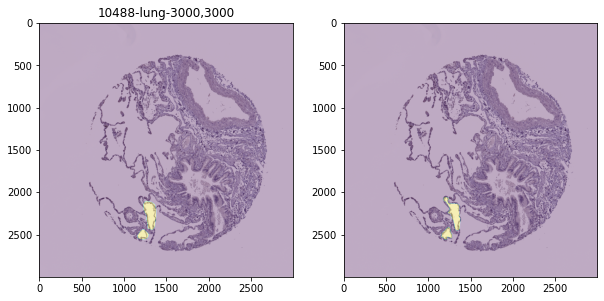

0.7955840455840456 0.9153286791283224


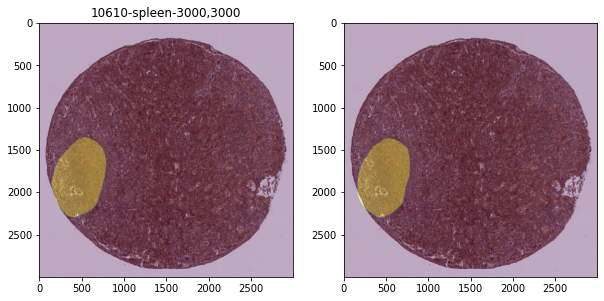

0.9781246013855134 0.9278878635797605


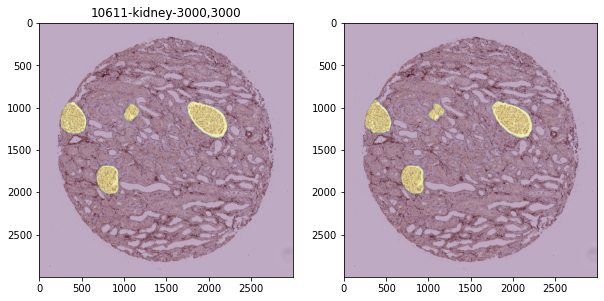

0.9737497449730489 0.935531510478642


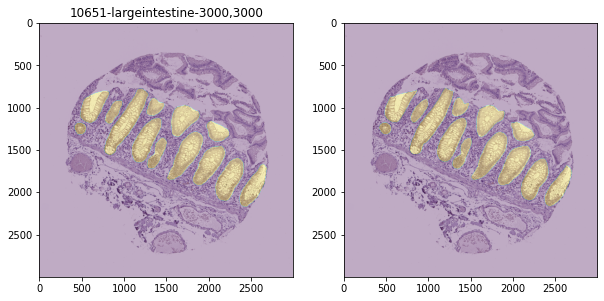

0.961688963636827 0.9392682895012399


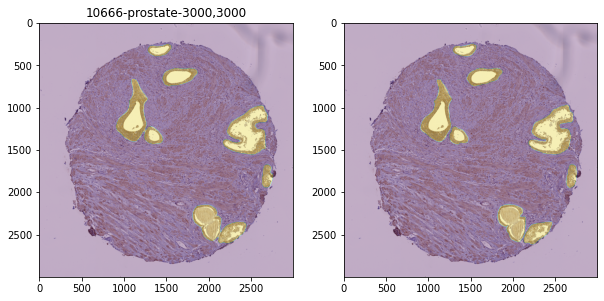

0.9635066874060356 0.9422980892393393


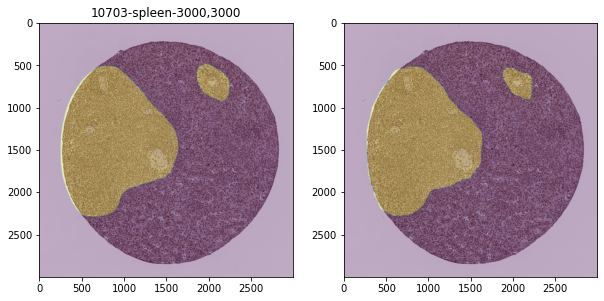

0.9764233589011551 0.94608978586843


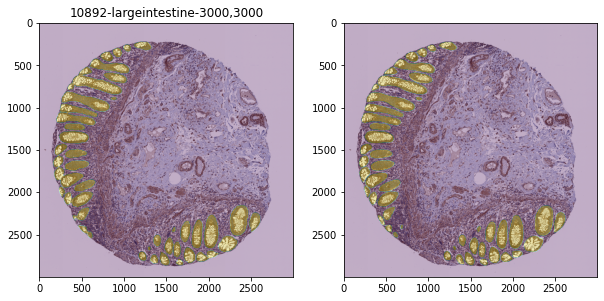

0.9453268614669356 0.9460134934282804


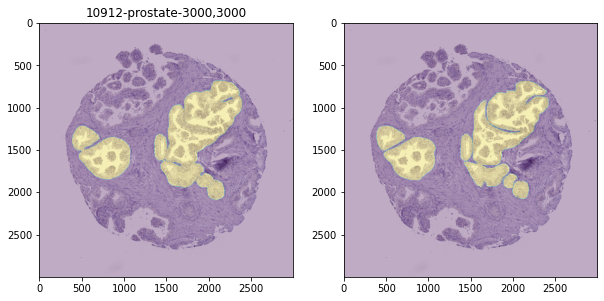

0.9534197501406995 0.9466867894930459


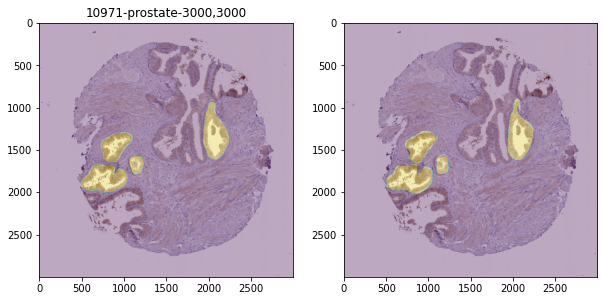

0.9339883914911163 0.9456285896595517


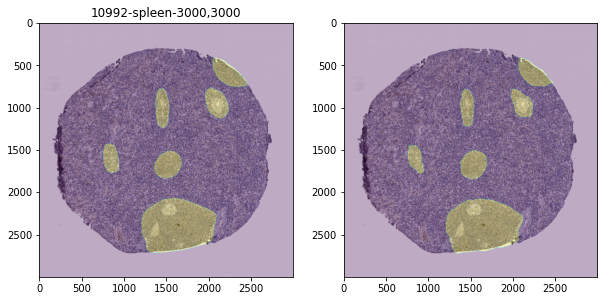

0.9618877475063272 0.9468792941093037


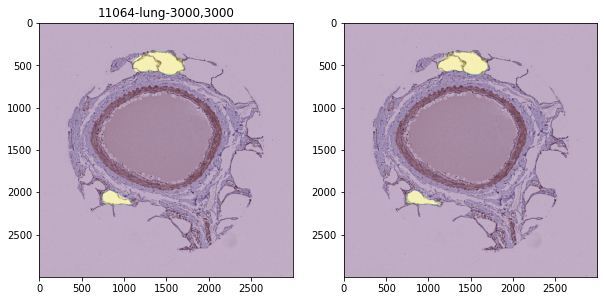

0.9392193701708328 0.9463321566851272


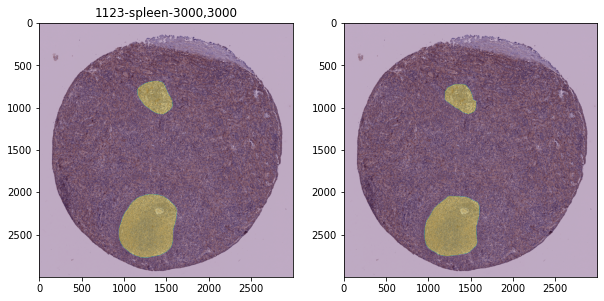

0.9403032223704967 0.9459302277308185


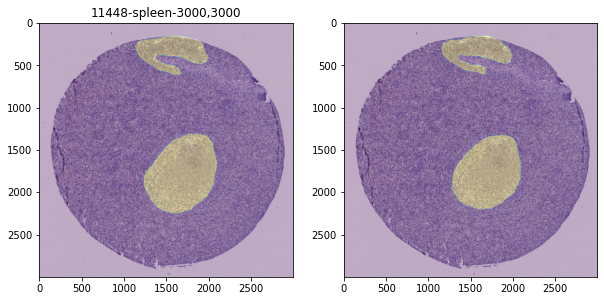

0.949824106183414 0.9461735951341057


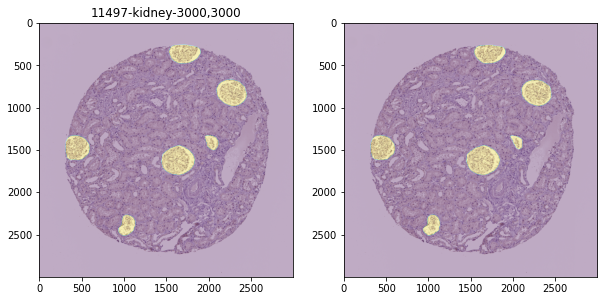

0.9758155341464473 0.94791723860542


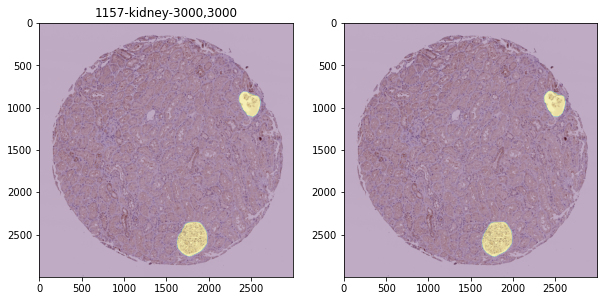

0.9835359826606804 0.9498960577196011


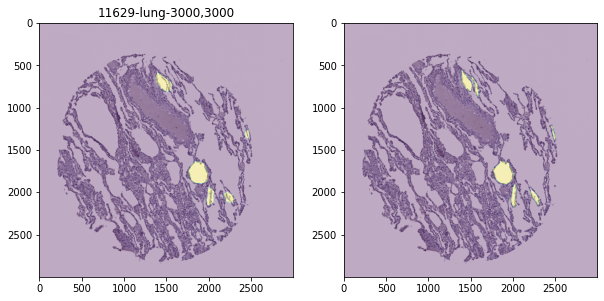

0.8109135267273514 0.9425811876673774


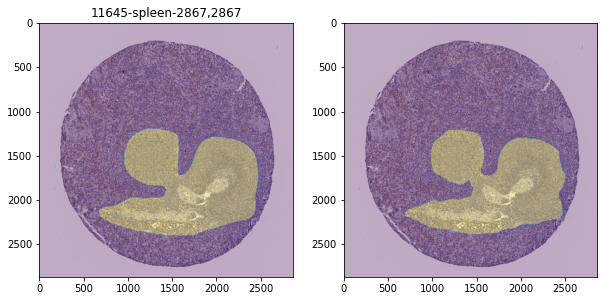

0.9642882756730388 0.9436665420676604


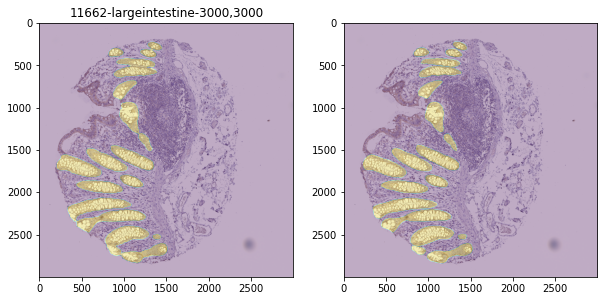

0.9583851713556576 0.9443674291766128


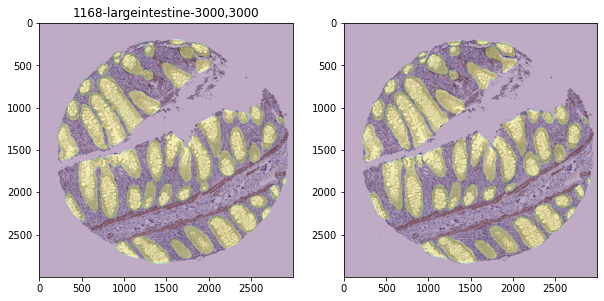

0.9491223836018668 0.9445835634686698


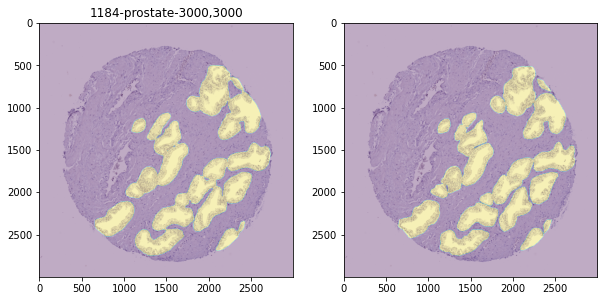

0.9499898520663769 0.9448186194946571


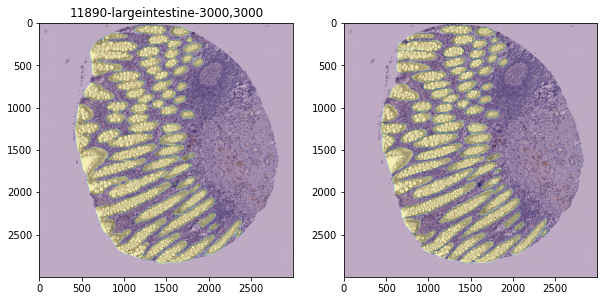

0.9422073361401995 0.9447098160215547


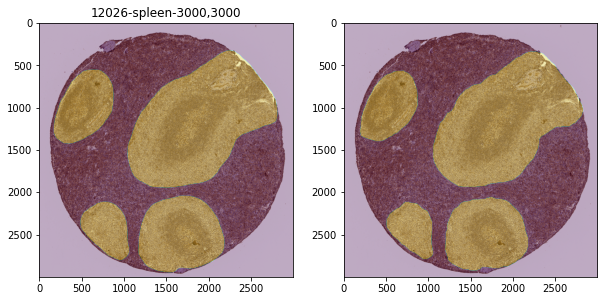

0.9737670590436317 0.9458721057424377


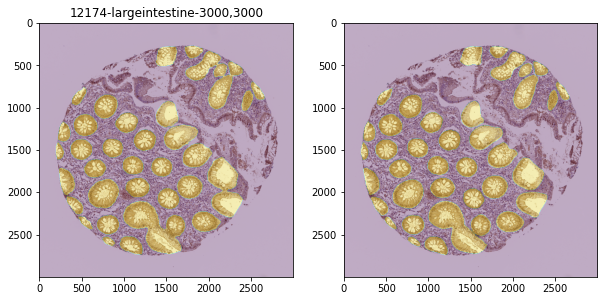

0.966759457594847 0.9466754654290688


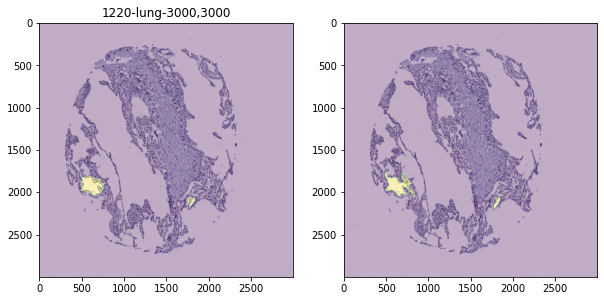

0.7397758001456713 0.9390125148630171


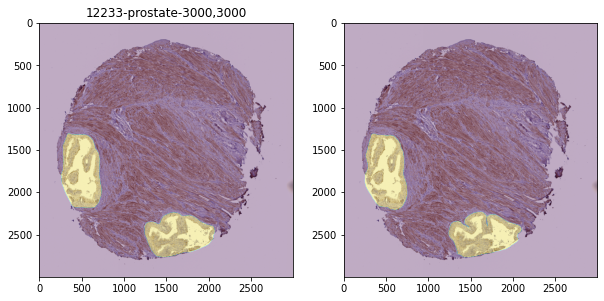

0.9712491703610259 0.9401638239879461


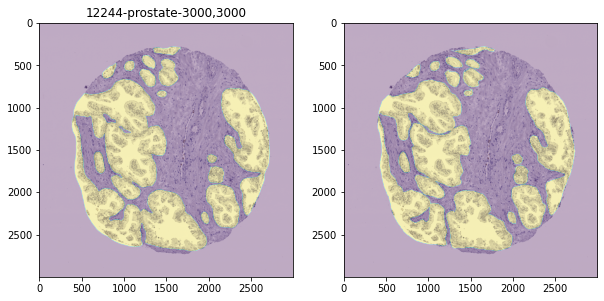

0.9500765773137346 0.9405056430681455


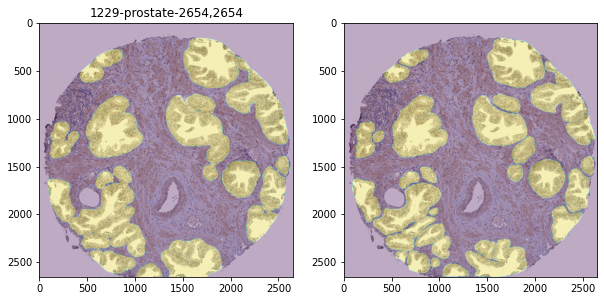

0.9551387585940536 0.9409934135856759


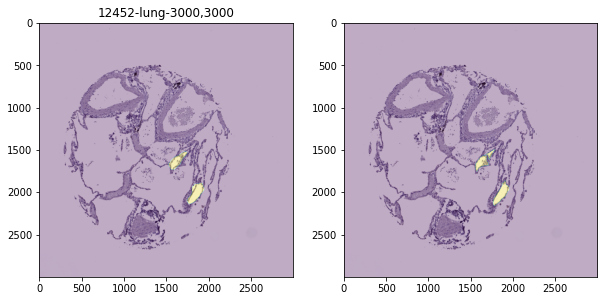

0.8291352071569063 0.9373850843460381


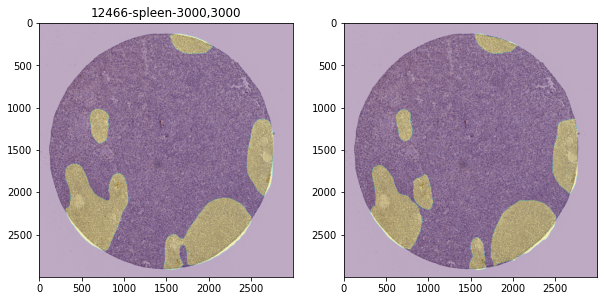

0.946783313932663 0.9376787790206201


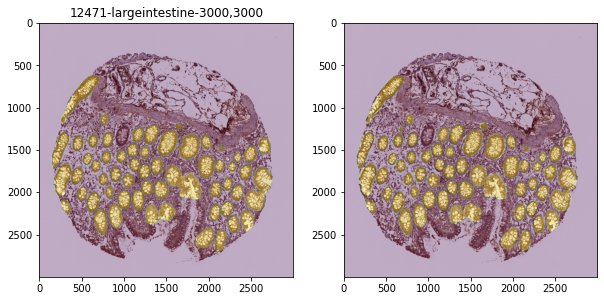

0.9548014760050081 0.9381976486262077


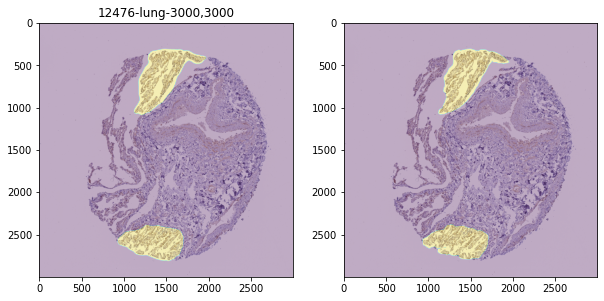

0.9573949852004815 0.9387622761725098


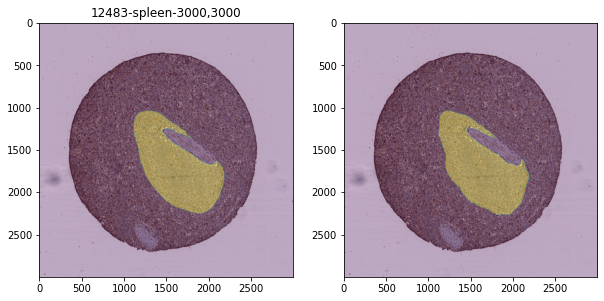

0.9738008635603413 0.9397633786693049


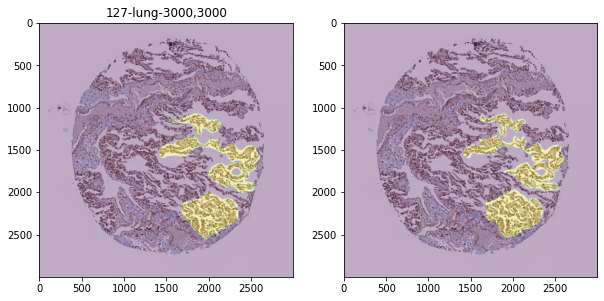

0.9127519241616623 0.939013060488537


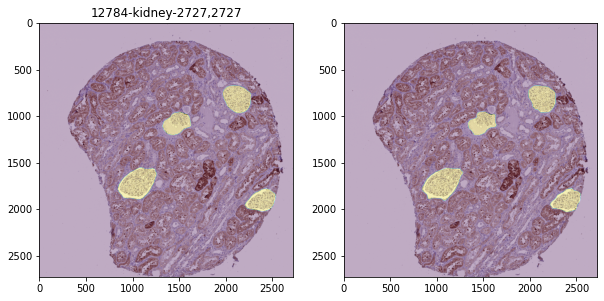

0.967615109378013 0.9397860888369014


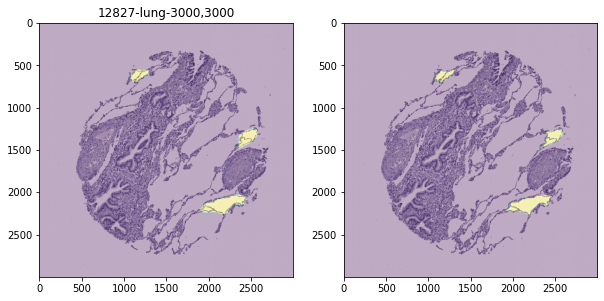

0.8825280360195106 0.9382792979732857


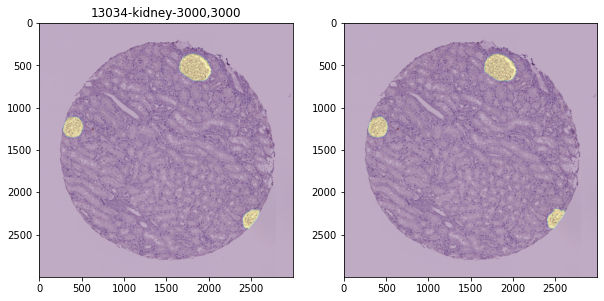

0.9786261713818305 0.9393138331888895


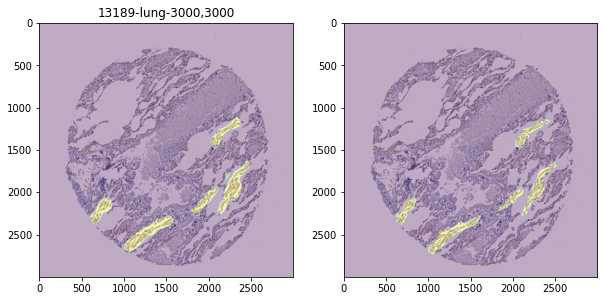

0.8090710219504313 0.9360577629079281


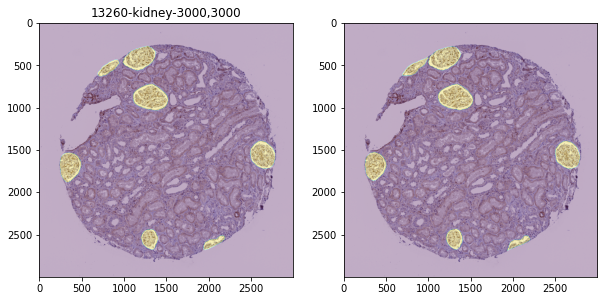

0.9713584627871421 0.9369187555879089


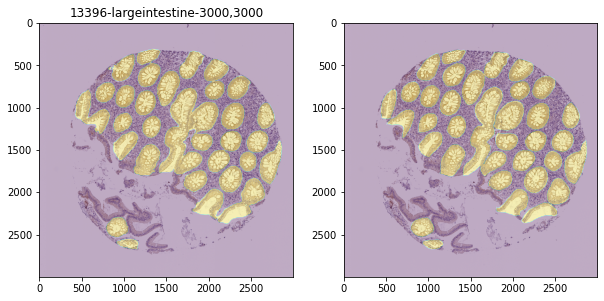

0.957834160779072 0.9374167414257938


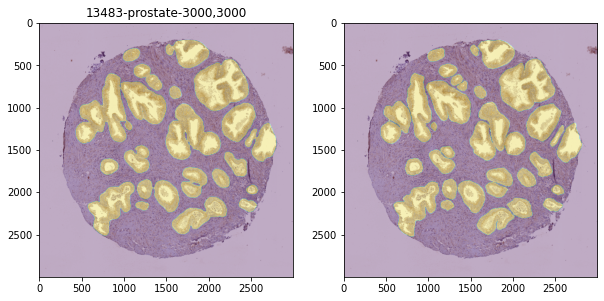

0.9558717442520687 0.9378459275380328


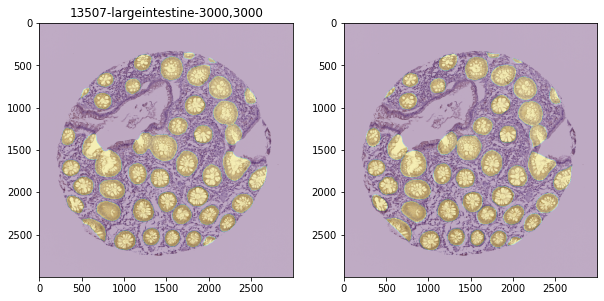

0.9550244896048076 0.9382363494031868


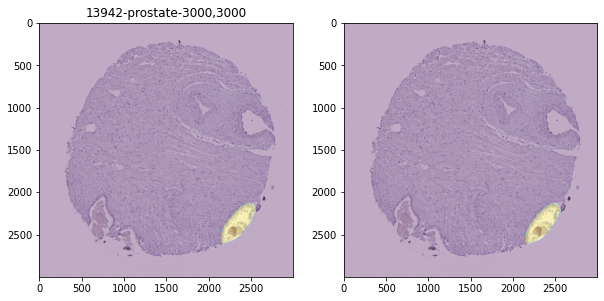

0.9813266268469035 0.9391939111241582


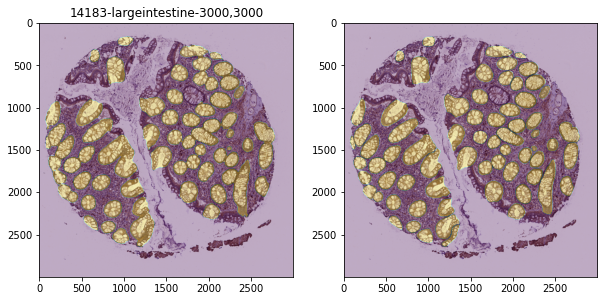

0.9537064587169876 0.9395094012892197


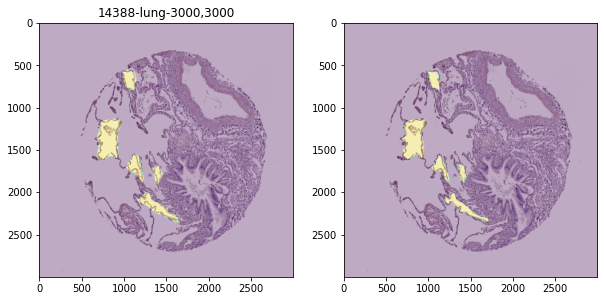

0.8670715309354046 0.937968170005096


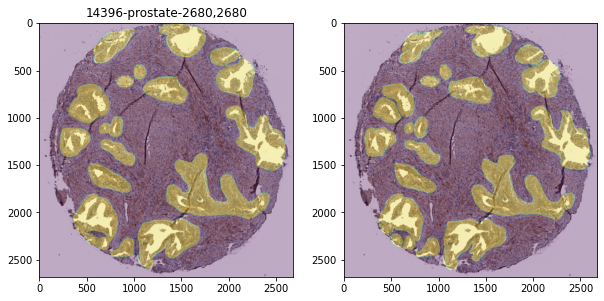

0.9498653854524597 0.9382160286602494


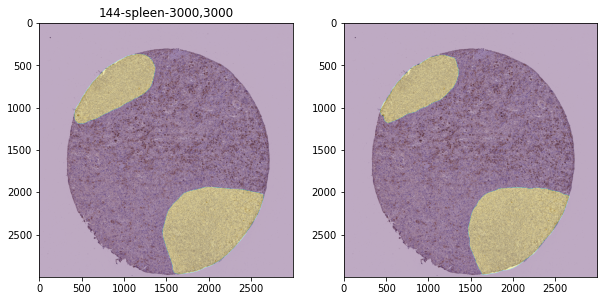

0.9818589303246165 0.9391067001227876


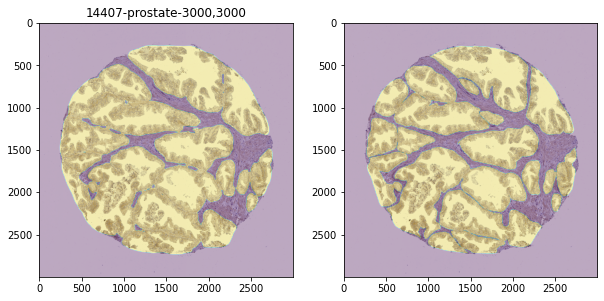

0.9554241265595506 0.9394330486515229


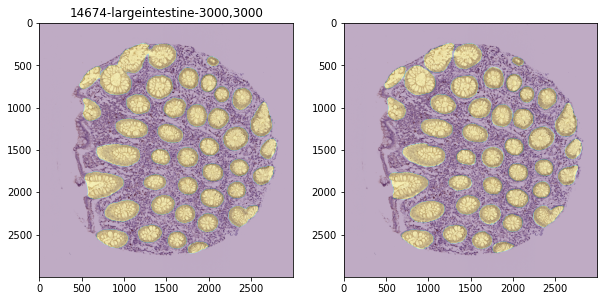

0.960939198793754 0.939854737869998


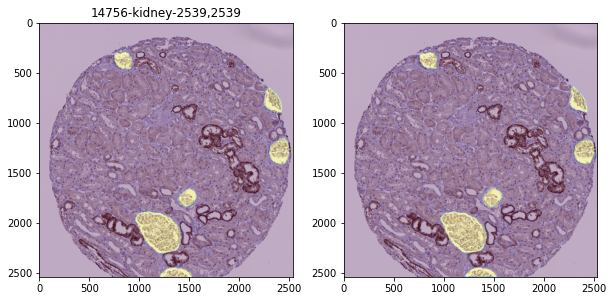

0.9659578539309519 0.9403567208711702


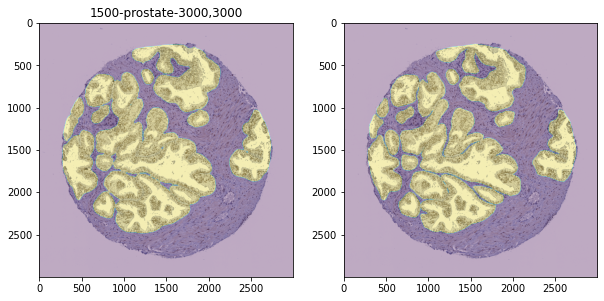

0.9647698120071393 0.9408173452322262


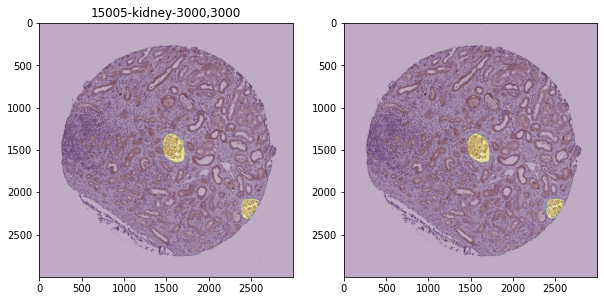

0.9826027831920584 0.9415911496388897


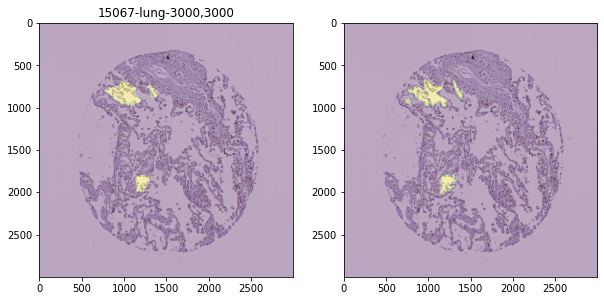

0.8318351054908932 0.9395955851998353


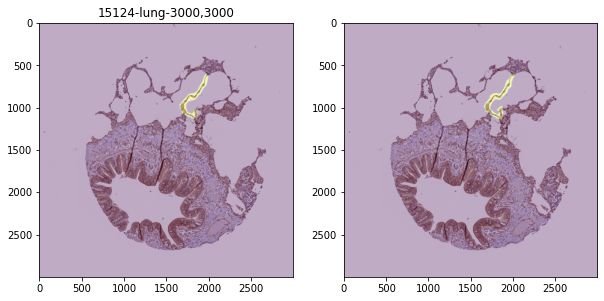

0.8729156716572877 0.9384048724580041


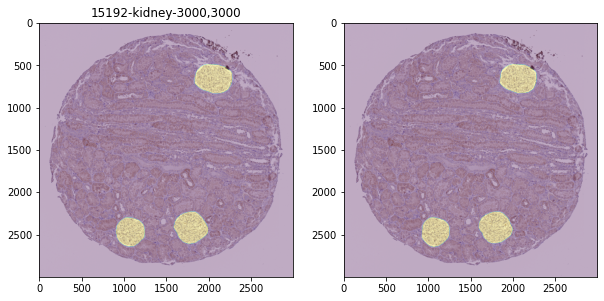

0.9830961788022948 0.9391889304640443


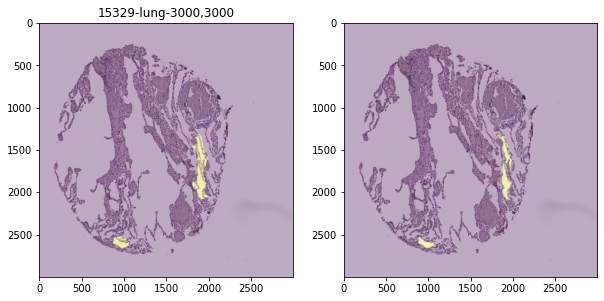

0.7733433517325088 0.9363295239341901


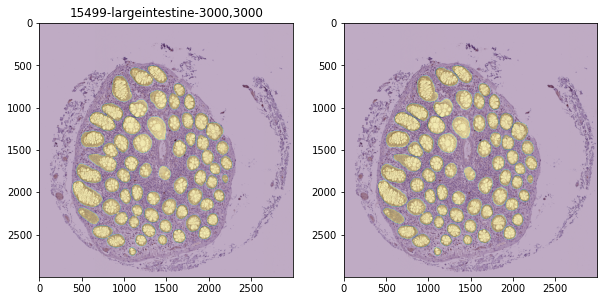

0.9670898347594337 0.936850885134618


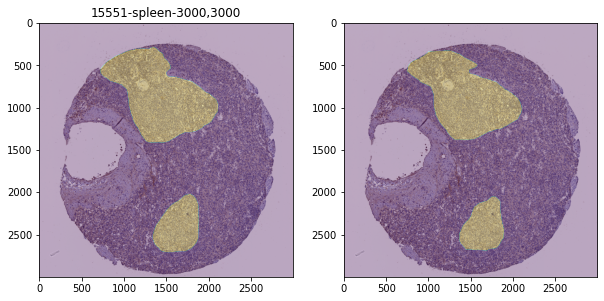

0.95402613872579 0.9371371393611375


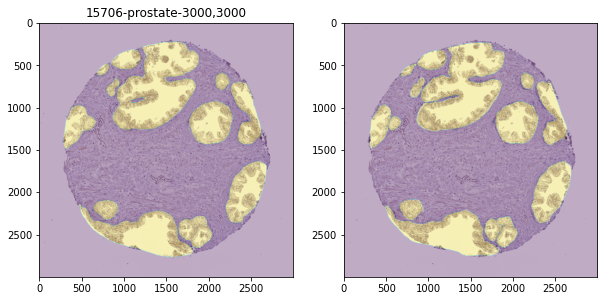

0.9596039862236818 0.9375054483260973


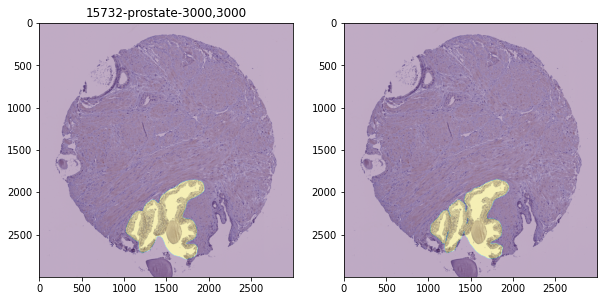

0.9711098606055446 0.9380474549757658


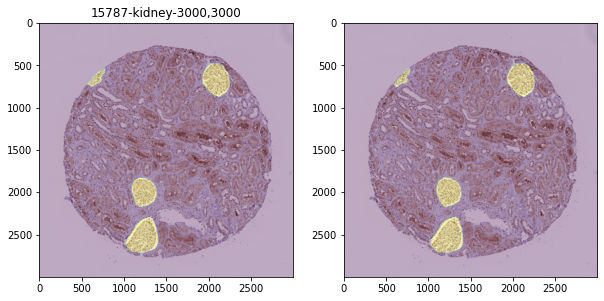

0.9772358724880432 0.9386694933489765


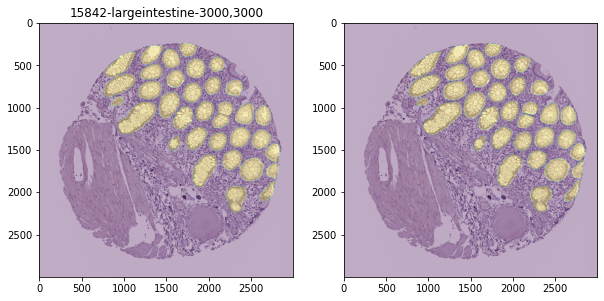

0.9615297068249291 0.9390266841845383


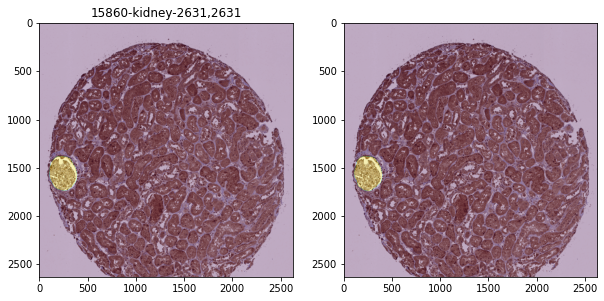

0.98072694665209 0.939668226684039


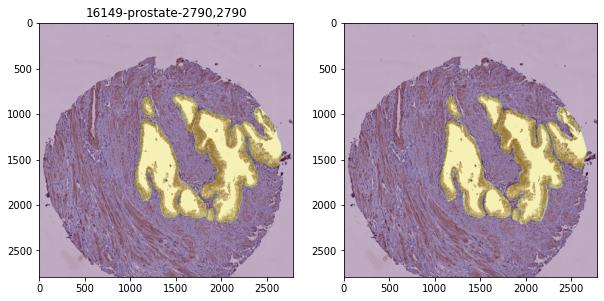

0.9688835003039221 0.9401108823449464


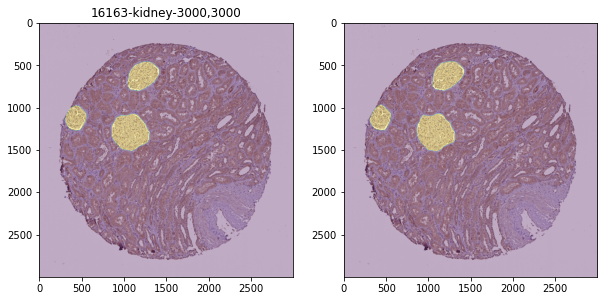

0.975767045501618 0.9406430638845983


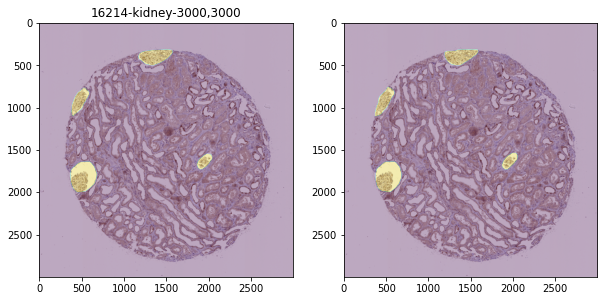

0.9626629234031406 0.9409668853481064


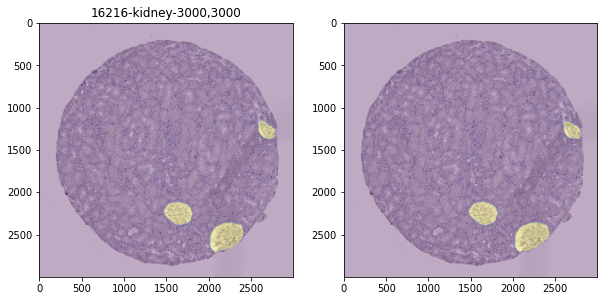

0.9724857429241526 0.9414236803854403


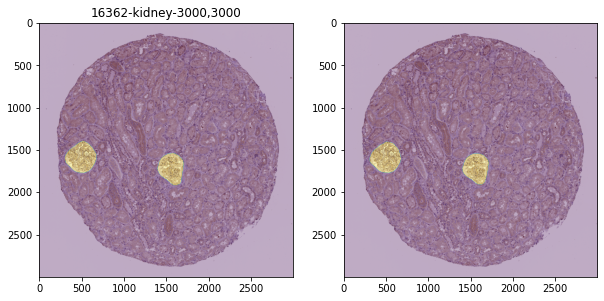

0.981329641665954 0.9419937655465905


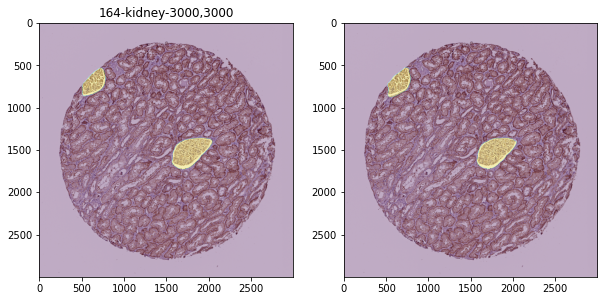

0.9716657418207761 0.9424116807053818


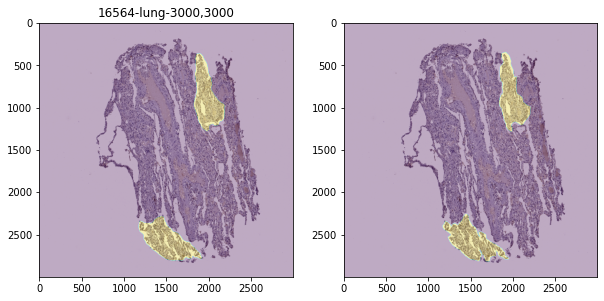

0.9430448826774799 0.9424204751772165


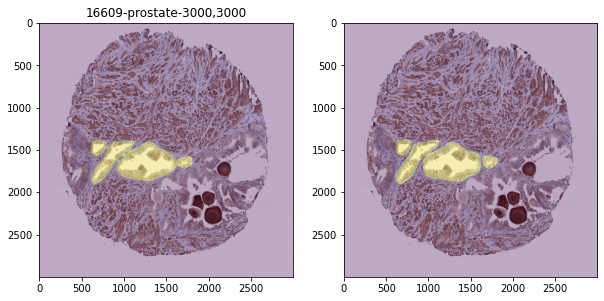

0.9525844649338341 0.9425597079136085


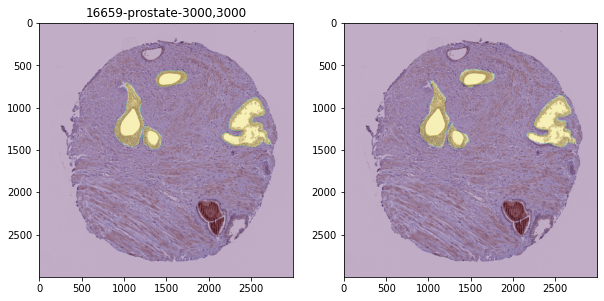

0.9325258606734442 0.9424241153833361


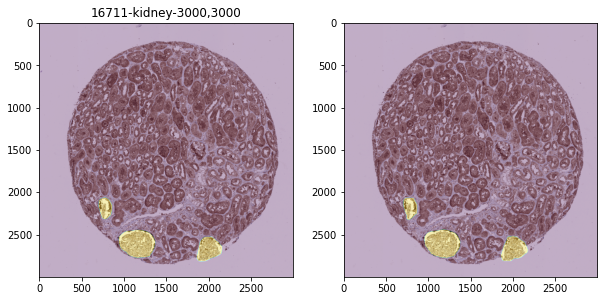

0.9693117789899535 0.9427826175647577


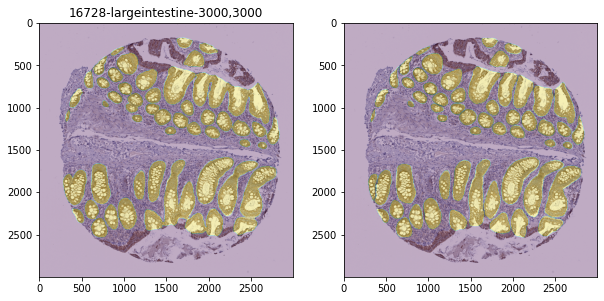

0.963777155487 0.9430588614847871


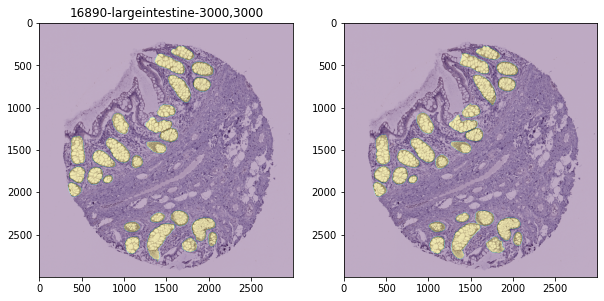

0.9540375994401327 0.9432014424971941


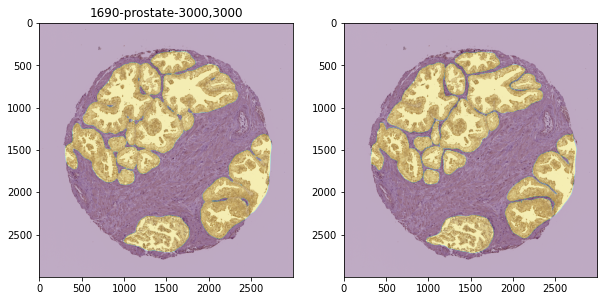

0.9668033900768271 0.943504031568728


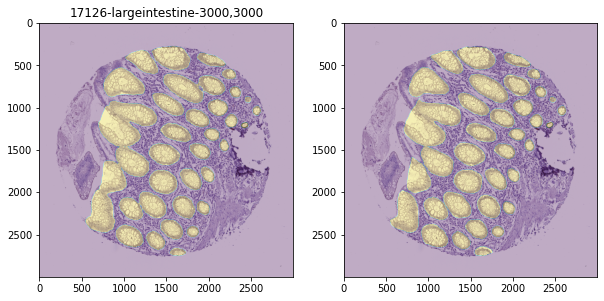

0.9590184203409869 0.9437004162367312


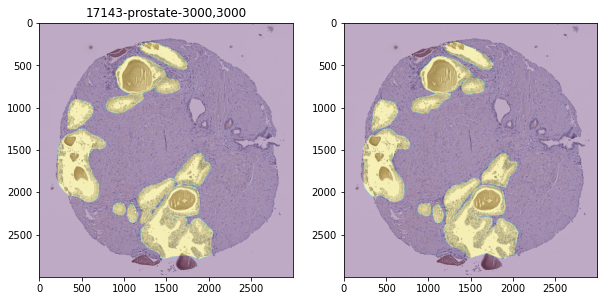

0.9682681017489119 0.9440075123056335


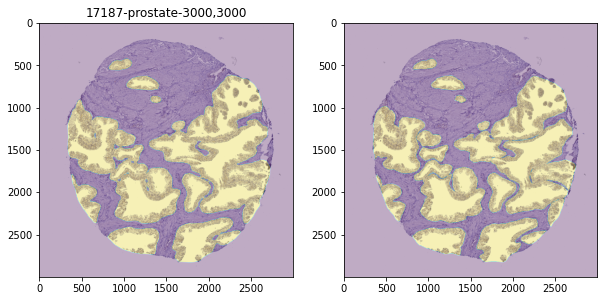

0.9652724728863857 0.9442700426831736


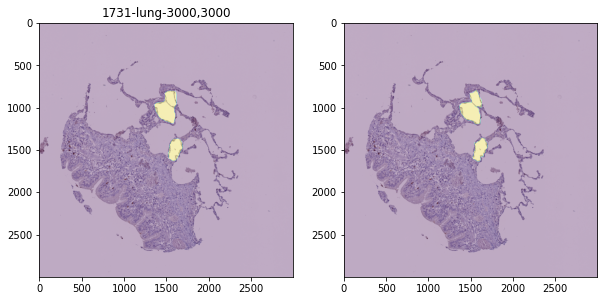

0.9213823093529976 0.9439909239840251


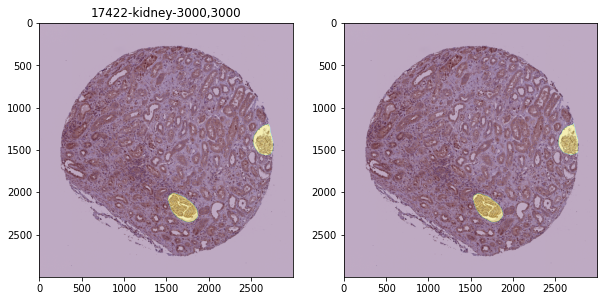

0.9784548422198042 0.9444061519145767


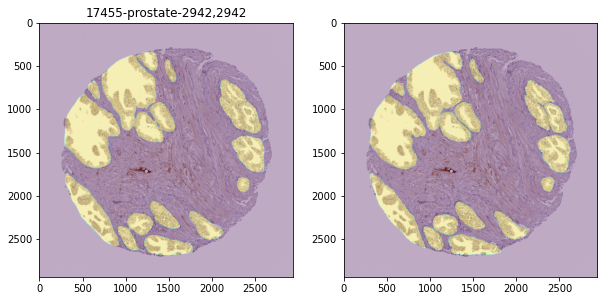

0.9576930938056291 0.944564329794232


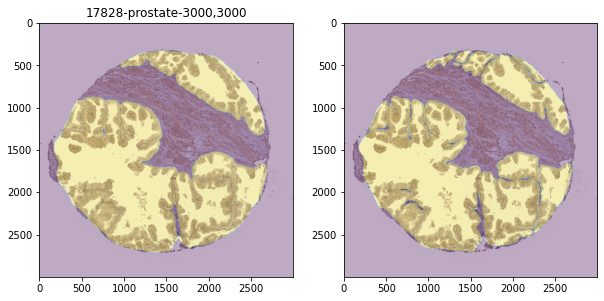

0.9743958594470793 0.9449152889666186


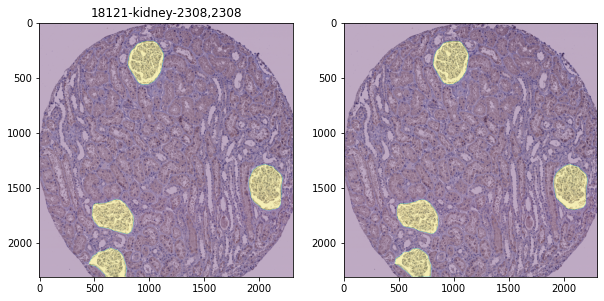

0.985641736773242 0.9453888523132072


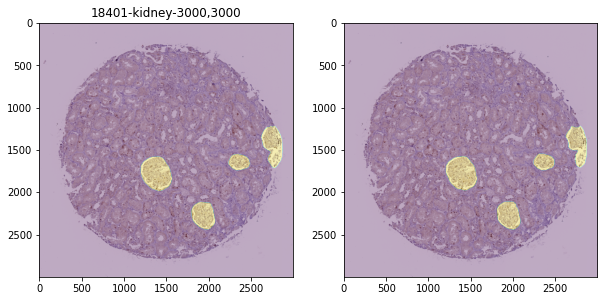

0.9675693087657561 0.945643800088524


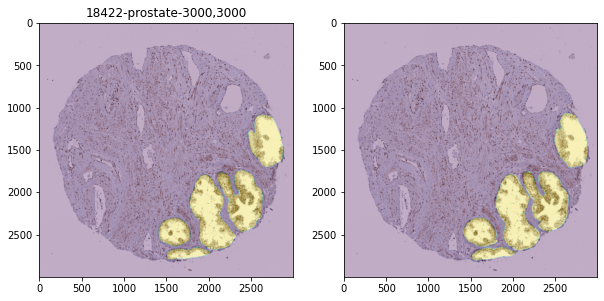

0.957426706548926 0.9457776967528467


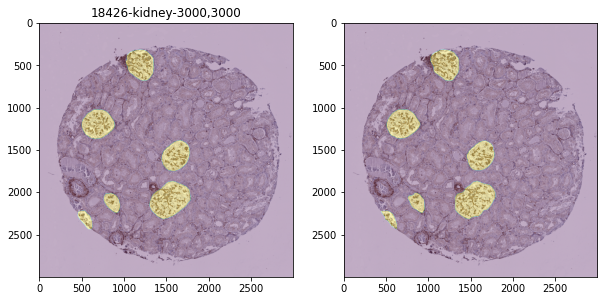

0.9713216486914718 0.9460647074487863


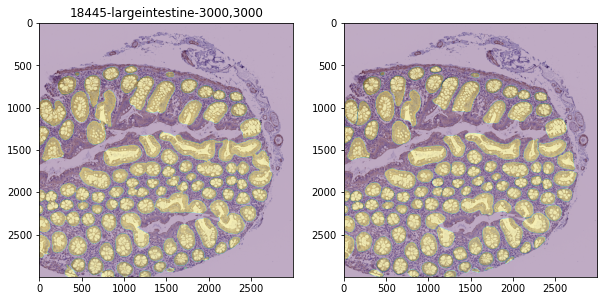

0.9539872756028045 0.946152735983831


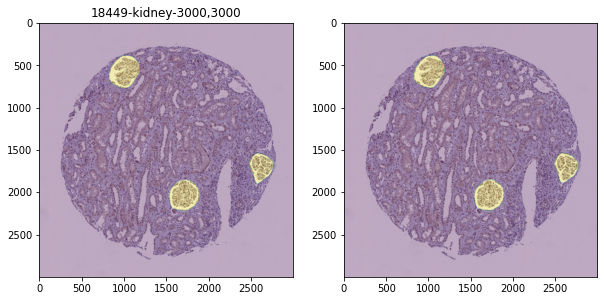

0.9867004072031293 0.9465983147884386


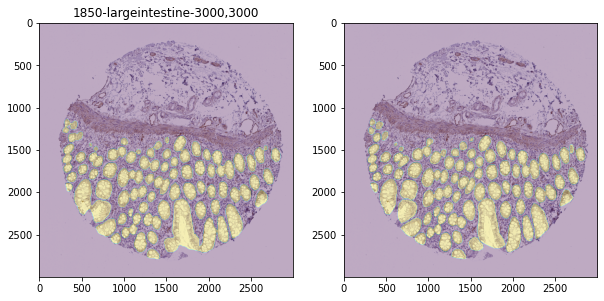

0.9442377833816156 0.9465726568383644


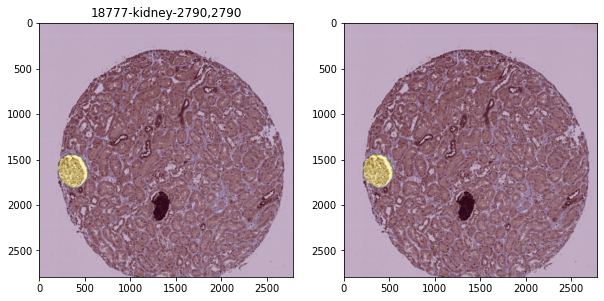

0.9782652787142254 0.94691343771875


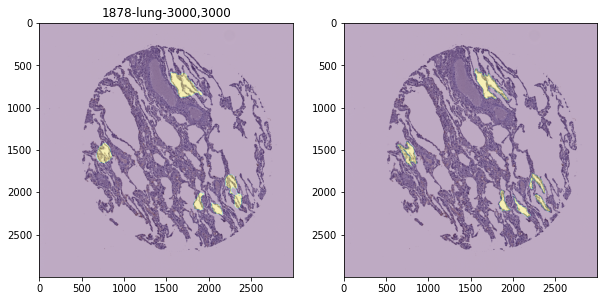

0.7195799279667088 0.9444949961256432


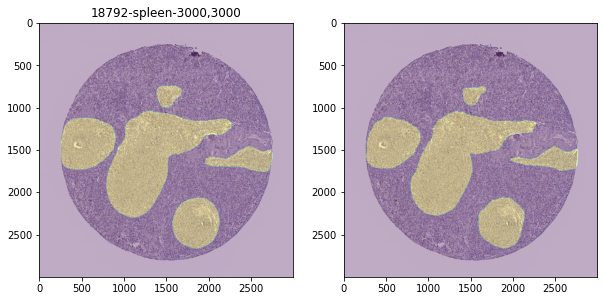

0.9550569417436849 0.94460617450057


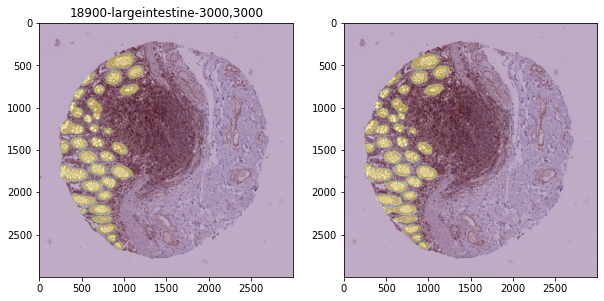

0.926871457543877 0.9444214378656045


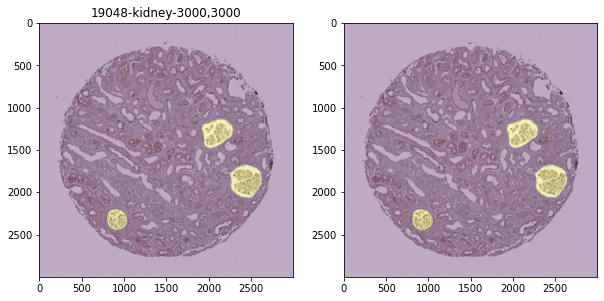

0.9867037208350079 0.9448573376900314


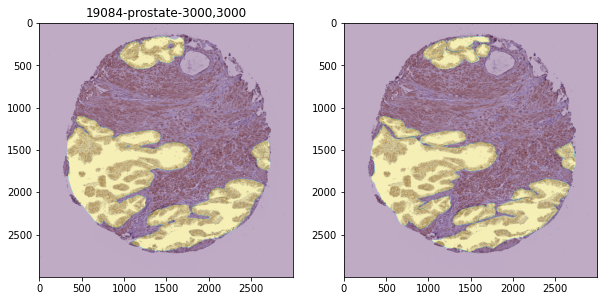

0.9635108674221159 0.9450476798301547


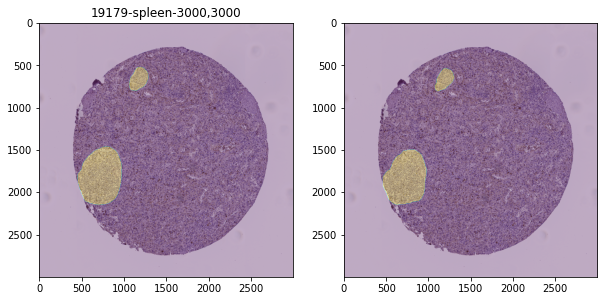

0.9393386301901745 0.9449900126620742


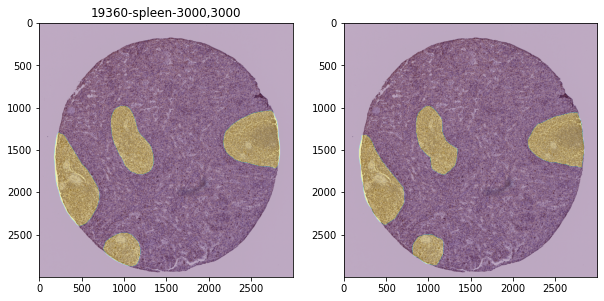

0.9479062029888365 0.9450191745653417


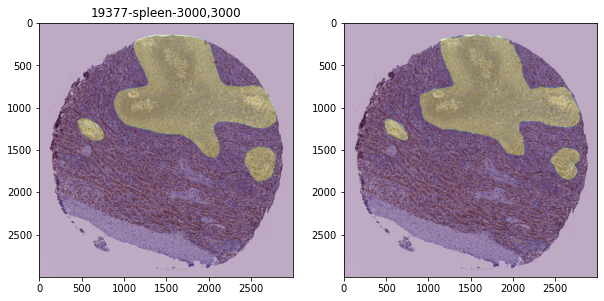

0.9714702157945612 0.9452810660626608


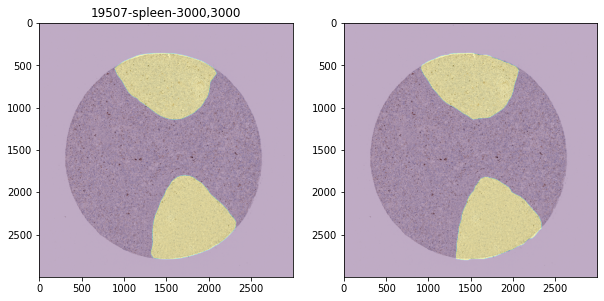

0.9758400840962618 0.9455806642786765


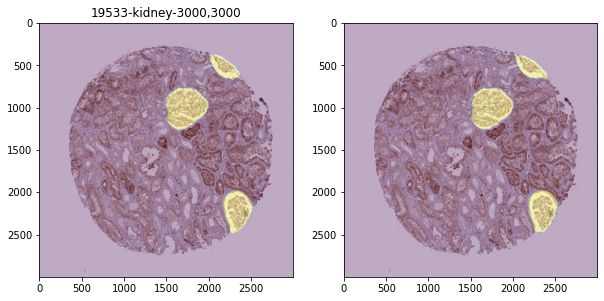

0.9686076186776162 0.9458042269427438


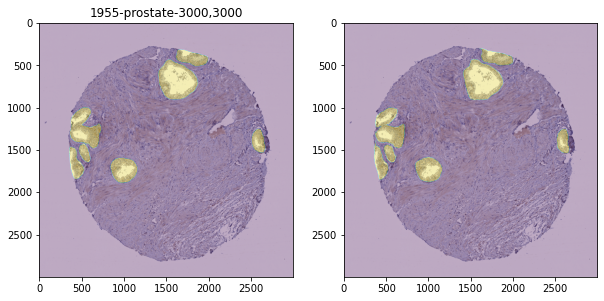

0.9555744931604668 0.945898171810222


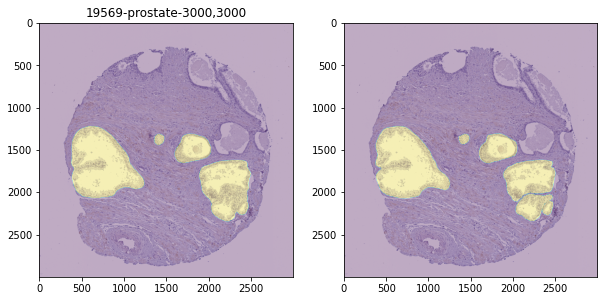

0.9767152261905495 0.9461916675662251


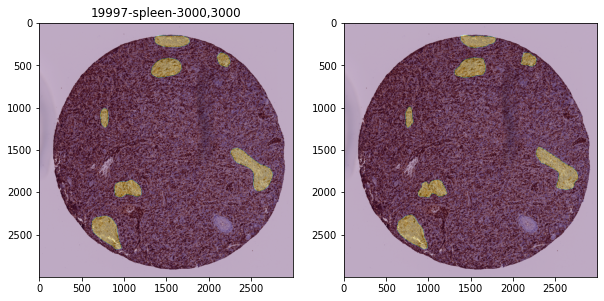

0.935965883524695 0.9460951979054559


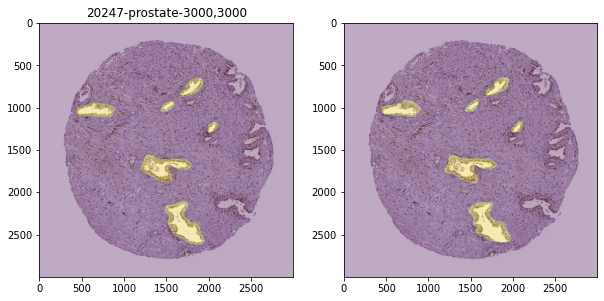

0.9255391406593839 0.9459030852209133


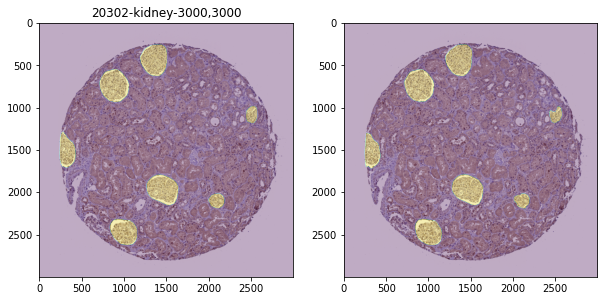

0.9730764404454072 0.9461546903618808


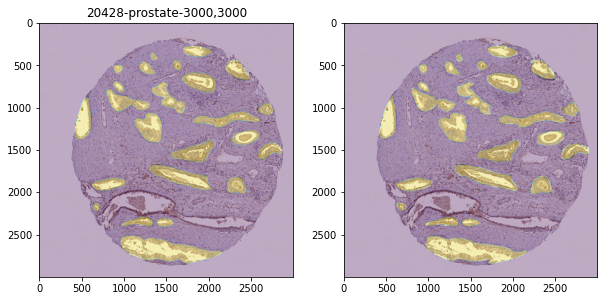

0.9457751201085651 0.9461512080659789


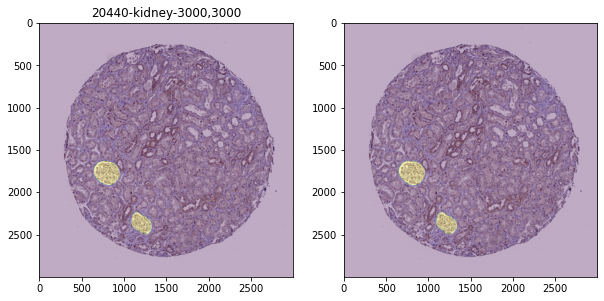

0.9786054159960814 0.9464462463198888


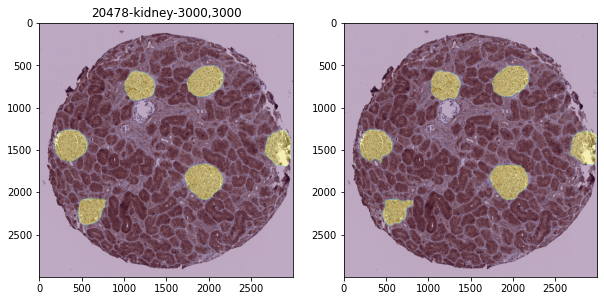

0.9619544329072871 0.9465859597125682


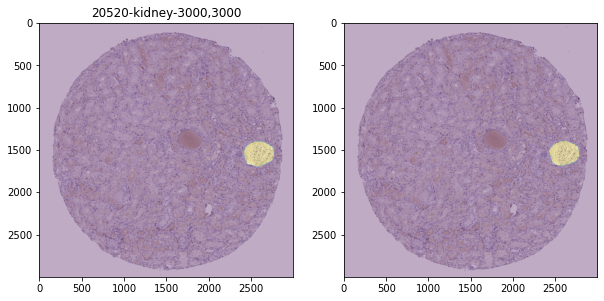

0.9680464866972031 0.9467775715606452


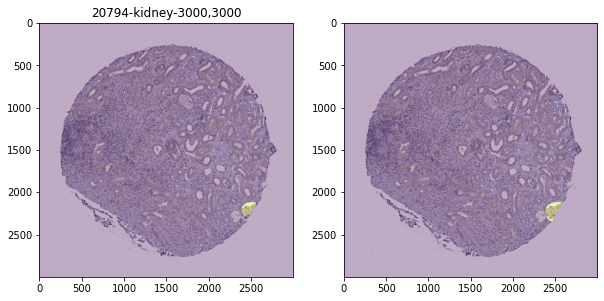

0.8310046573519627 0.9457530324968517


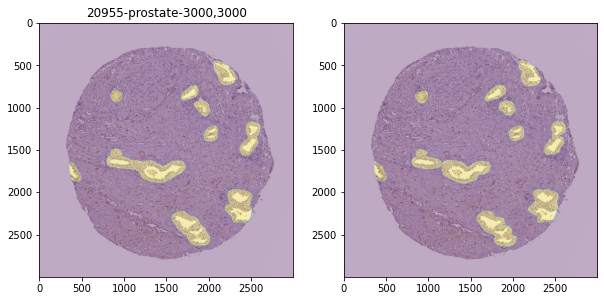

0.9407389610253946 0.9457090494137687


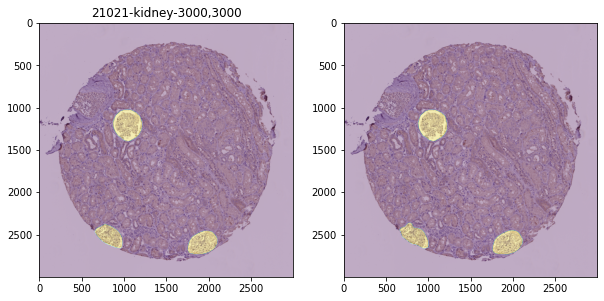

0.9753627936064939 0.9459669080589228


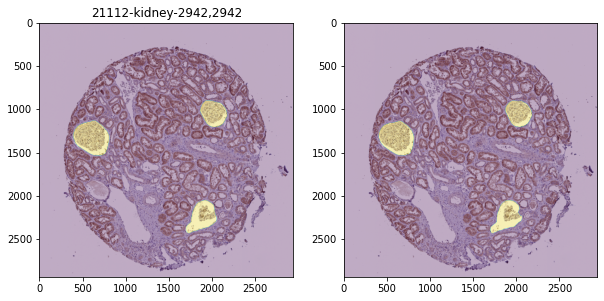

0.9762150288527416 0.9462276677209384


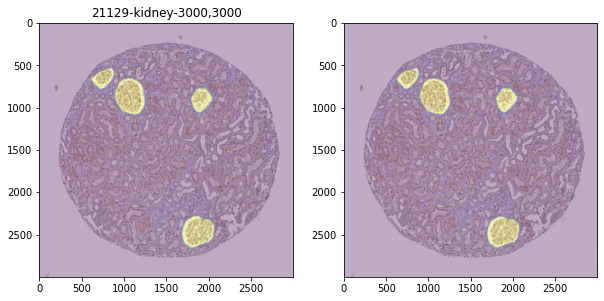

0.9816726933614561 0.9465306166580368
DICE =  0.9465306166580368


In [ ]:
from PIL import Image
from transformers import SegformerFeatureExtractor
feature_extractor = SegformerFeatureExtractor(reduce_labels=False, size=(WIDTH, HEIGHT))

# print(pixel_values.shape)
# image = Image.open('/content/hubmap/train_images/10651.tiff')
# plt.imshow(image)

model2.eval()
dice = 0.0

test_df = df[df['fold'] == FOLD].reset_index()
for i in range(len(test_df)) :
  id = test_df.id[i]
  fname = "/content/hubmap/train_images/{}.tiff".format(id)
  image = Image.open(fname)
  encoding = feature_extractor(image, return_tensors="pt")
  pixel_values = encoding.pixel_values.cuda()
  organ = test_df.organ[i]
  rle = test_df.rle[i]
  height, width = test_df.img_height[i], test_df.img_width[i]
  idx = class2idx[organ]
  with torch.no_grad():
    outputs = model2(pixel_values=pixel_values)
    upsampled_logits = nn.functional.interpolate(outputs['logits'],
                # size=image.size[::-1], # (height, width)
                (height, width),
                mode='bilinear',
                align_corners=False)
    mask = upsampled_logits.argmax(dim=1)[0]
    mask[mask != idx] = 0
    mask[mask == idx] = 1

  gt = rle2mask(rle, shape = (height, width))
  plt.figure(figsize=(10,10))
  plt.subplot(1, 2, 1)
  plt.imshow(image)
  plt.imshow(mask.cpu().numpy(), alpha=0.3)
  plt.title("{}-{}-{},{}".format(id, organ, width, height))
  plt.subplot(1, 2, 2)
  plt.imshow(image)
  plt.imshow(gt, alpha=0.3)
  plt.show()

  dice += dice_coef(mask.cpu().numpy(), gt)
  print(dice_coef(mask.cpu().numpy(), gt), dice/(i+1))

print("DICE = ", dice/len(test_df))

In [ ]:
len(test_df)

117

In [ ]:
def calc_resize(w, p) :
    a = 3000/512
    target = int((w*p/0.4)/a + 0.5)
    target = (target+31)//32 * 32
    return target

calc_resize(2023, 0.4945), calc_resize(3000, 0.4), calc_resize(160, 6.263), calc_resize(4500, 0.2290)

(448, 512, 448, 448)

In [ ]:
!pip install staintools
!pip install spams

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# 多くのカグラーは染色ツールを使用して、増強のために組織画像の色を着色しています。
# 彼らは他のより重要な側面を見逃しています：テクスチャ（すなわち形態）
import staintools

# Read data
to_augment = staintools.read_image("/content/hubmap/train_images/10044.tiff")

# Standardize brightness (optional, can improve the tissue mask calculation)
# to_augment = staintools.LuminosityStandardizer.standardize(to_augment)

# Stain augment
augmentor = staintools.StainAugmentor(method='vahadane', sigma1=0.2, sigma2=0.2)

augmentor.fit(to_augment)
augmented_images = []
for _ in range(2):
    augmented_image = augmentor.pop()
    augmented_images.append(augmented_image)

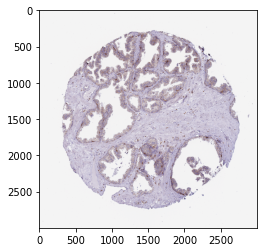

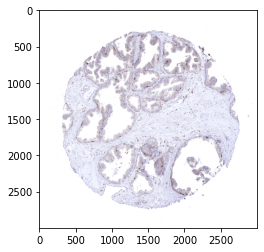

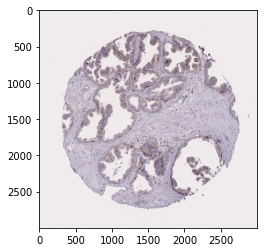

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(to_augment)
plt.show()
for e in augmented_images:
  plt.imshow(e/255)
  plt.show()